# Lending Club Case Study


## Introduction

## Goal

Exploring how data can be leveraged to reduce the financial risk associated with lending to customers. 

### Risk associated with the problem

If the applicant is ***likely to repay the loan***, then not approving loan is a loss of business to the company (Rejecting the loans for non - defaulters).

If the applicant is ***not likely to repay the loan*** (i.e. he/she likey to default), then in that case approving the loan may lead to financial loss to the company (Approving the loans for defaulters).

The data given below contains information about past loan applicants and whether they ‘defaulted’ or not.
Each row represents the loan details of the applicants.


### Objective:

The company aims to gain insights into the root causes, or influential variables, contributing to loan defaults—those variables that serve as robust indicators of default. This acquired knowledge can be leveraged by the company to enhance its portfolio management and risk assessment.

#### Import Python Libraries

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns
sns.set_palette('muted')
import warnings
warnings.filterwarnings('ignore')

In [2]:
# set the max columns to none to see all the columns & rows in dataset

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#### Import the Loan Dataset

In [3]:
loan_original = pd.read_csv("loan.csv")
loan_original.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,NaN,NaN,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0,Feb-96,1,35.0,NaN,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,NaN,Apr-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

#### Creating a Duplicate of the Dataset for Exploratory Data Analysis (EDA)

In [4]:
loan_copy = loan_original.copy()
loan_copy.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,NaN,NaN,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0,Feb-96,1,35.0,NaN,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,NaN,Apr-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

#### Checking the shape

In [5]:
#Checking the number of rows & Columns in dataset.

loan_copy.shape

(39717, 111)

In [6]:
# Checking the datatypes
loan_copy.dtypes

id                                  int64
member_id                           int64
loan_amnt                           int64
funded_amnt                         int64
funded_amnt_inv                   float64
term                               object
int_rate                           object
installment                       float64
grade                              object
sub_grade                          object
emp_title                          object
emp_length                         object
home_ownership                     object
annual_inc                        float64
verification_status                object
issue_d                            object
loan_status                        object
pymnt_plan                         object
url                                object
desc                               object
purpose                            object
title                              object
zip_code                           object
addr_state                        

In [7]:
# Description the DataFrame(Loans Data)

loan_copy.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
count,3.971700e+04,3.971700e+04,39717.000000,39717.000000,39717.000000,39717.000000,3.971700e+04,39717.000000,39717.000000,39717.000000,14035.000000,2786.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39661.0,0.0,39717.0,0.0,0.0,0.0,39717.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39661.0,39717.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39020.000000,39678.0,0.0,0.0,0.0,0.0
mean,6.831319e+05,8.504636e+05,11219.443815,10947.713196,10397.448868,324.561922,6.896893e+04,13.315130,0.146512,0.869200,35.900962,69.698134,9.294408,0.055065,13382.528086,22.088828,51.227887,50.989768,12153.596544,11567.149118,9793.348813,2263.663172,1.363015,95.221624,12.406112,2678.826162,0.0,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.043260,0.0,NaN,NaN,NaN,NaN
std,2.106941e+05,2.656783e+05,7456.670694,7187.238670,7128.450439,208.874874,6.379377e+04,6.678594,0.491812,1.070219,22.020060,43.822529,4.400282,0.237200,15885.016641,11.401709,375.172839,373.824457,9042.040766,8942.672613,7065.522127,2608.111964,7.289979,688.744771,148.671593,4447.136012,0.0,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.204324,0.0,NaN,NaN,NaN,NaN
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,15.690000,4.000000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.0,NaN,NaN,NaN,NaN
25%,5.162210e+05,6.667800e+05,5500.000000,5400.000000,5000.000000,167.020000,4.040400e+04,8.170000,0.000000,0.000000,18.000000,22.000000,6.000000,0.000000,3703.000000,13.000000,0.000000,0.000000,5576.930000,5112.310000,4600.000000,662.180000,0.000000,0.000000,0.000000,218.680000,0.0,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [8]:
# Transpose of the DataFrame(Loans Data)

loan_copy.describe().T

,count,mean,std,min,25%,50%,75%,max
id,39717.0,683131.913060,210694.132915,54734.00,516221.00,665665.000000,8.377550e+05,1.077501e+06
member_id,39717.0,850463.559408,265678.307421,70699.00,666780.00,850812.000000,1.047339e+06,1.314167e+06
loan_amnt,39717.0,11219.443815,7456.670694,500.00,5500.00,10000.000000,1.500000e+04,3.500000e+04
funded_amnt,39717.0,10947.713196,7187.238670,500.00,5400.00,9600.000000,1.500000e+04,3.500000e+04
funded_amnt_inv,39717.0,10397.448868,7128.450439,0.00,5000.00,8975.000000,1.440000e+04,3.500000e+04
installment,39717.0,324.561922,208.874874,15.69,167.02,280.220000,4.307800e+02,1.305190e+03
annual_inc,39717.0,68968.926377,63793.765790,4000.00,40404.00,59000.000000,8.230000e+04,6.000000e+06
dti,39717.0,13.315130,6.678594,0.00,8.17,13.400000,1.860000e+01,2.999000e+01
delinq_2yrs,39717.0,0.146512,0.491812,0.00,0.00,0.000000,0.000000e+00,1.100000e+01
inq_last_6mths,39717.0,0.869200,1.070219,0.00,0.00,1.000000,1.000000e+00,8.000000e+00


In [9]:
loan_copy['term'].value_counts()

 36 months    29096
 60 months    10621
Name: term, dtype: int64

In [10]:
loan_copy['grade'].value_counts()

B    12020
A    10085
C     8098
D     5307
E     2842
F     1049
G      316
Name: grade, dtype: int64

In [11]:
loan_copy['sub_grade'].value_counts()

B3    2917
A4    2886
A5    2742
B5    2704
B4    2512
C1    2136
B2    2057
C2    2011
B1    1830
A3    1810
C3    1529
A2    1508
D2    1348
C4    1236
C5    1186
D3    1173
A1    1139
D4     981
D1     931
D5     874
E1     763
E2     656
E3     553
E4     454
E5     416
F1     329
F2     249
F3     185
F4     168
F5     118
G1     104
G2      78
G4      56
G3      48
G5      30
Name: sub_grade, dtype: int64

In [12]:
loan_copy['application_type'].value_counts()

INDIVIDUAL    39717
Name: application_type, dtype: int64

#### Missing Value Check in Percentage

In [13]:
loan_copy_missing = 100 * loan_copy.isnull().mean().round().sort_values(ascending = True)
loan_copy_missing

id                                  0.0
pub_rec                             0.0
revol_bal                           0.0
revol_util                          0.0
total_acc                           0.0
initial_list_status                 0.0
out_prncp                           0.0
out_prncp_inv                       0.0
total_pymnt                         0.0
chargeoff_within_12_mths            0.0
total_rec_prncp                     0.0
total_rec_int                       0.0
total_rec_late_fee                  0.0
recoveries                          0.0
collection_recovery_fee             0.0
last_pymnt_d                        0.0
last_pymnt_amnt                     0.0
tax_liens                           0.0
last_credit_pull_d                  0.0
collections_12_mths_ex_med          0.0
pub_rec_bankruptcies                0.0
policy_code                         0.0
application_type                    0.0
acc_now_delinq                      0.0
open_acc                            0.0


In [14]:
## Segreate the Columns :- 


loan_copy.head(2)

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.0,0.0,5863.155187,5833.84,5000.00,863.16,0.0,0.00,0.00,Jan-15,171.62,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.0,0.0,1008.710000,1008.71,456.46,435.17,0.0,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [15]:
loan_copy_missing_1= loan_copy_missing > 90.0
loan_copy_missing_2 = loan_copy_missing[loan_copy_missing_1]
loan_copy_missing_2

num_actv_bc_tl                    100.0
num_accts_ever_120_pd             100.0
mths_since_recent_revol_delinq    100.0
mths_since_recent_inq             100.0
mo_sin_old_rev_tl_op              100.0
mths_since_recent_bc              100.0
mort_acc                          100.0
mo_sin_rcnt_tl                    100.0
mo_sin_rcnt_rev_tl_op             100.0
num_actv_rev_tl                   100.0
mths_since_recent_bc_dlq          100.0
num_bc_sats                       100.0
num_sats                          100.0
num_il_tl                         100.0
num_op_rev_tl                     100.0
num_rev_accts                     100.0
num_rev_tl_bal_gt_0               100.0
num_tl_120dpd_2m                  100.0
num_tl_30dpd                      100.0
num_tl_90g_dpd_24m                100.0
total_bal_ex_mort                 100.0
num_tl_op_past_12m                100.0
pct_tl_nvr_dlq                    100.0
tot_hi_cred_lim                   100.0
num_bc_tl                         100.0


In [16]:
# Drop all the columns with more than 60% null values.

loan_dropNA = loan_copy.dropna(thresh=loan_copy.shape[0]*0.6,axis=1)
loan_dropNA.shape

(39717, 54)

In [17]:
loan_dropNA.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,policy_code,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,Sep-13,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0,Feb-96,1,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,Apr-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,University Medical Group,1 year,RENT,80000.0,Source Verified,Dec-11,Current,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0,Jan-96,0,15,0,27783,53.90%,38,f,524.06,524.06,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0


In [18]:
#Checking the number of unique values in each columns
#It Would help in narrowing down the number of columns for our analysis
 
print("Number of unique values in each columns are: ->  \n")
loan_dropNA.nunique(axis=0)


Number of unique values in each columns are: ->  



id                            39717
member_id                     39717
loan_amnt                       885
funded_amnt                    1041
funded_amnt_inv                8205
term                              2
int_rate                        371
installment                   15383
grade                             7
sub_grade                        35
emp_title                     28820
emp_length                       11
home_ownership                    5
annual_inc                     5318
verification_status               3
issue_d                          55
loan_status                       3
pymnt_plan                        1
url                           39717
desc                          26527
purpose                          14
title                         19615
zip_code                        823
addr_state                       50
dti                            2868
delinq_2yrs                      11
earliest_cr_line                526
inq_last_6mths              

In [19]:
# Removing columns which has more than 50% of the values as unique values as they have no significance in analysis and are treated as random variables.

columns_to_drop = ['id','member_id','url','total_pymnt','total_pymnt_inv','total_rec_int','last_pymnt_amnt','emp_title','desc','revol_bal','title']
loan_dropUniqCol = loan_dropNA.drop(columns_to_drop, axis=1)
loan_dropUniqCol.info()
loan_dropUniqCol.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 43 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   loan_amnt                   39717 non-null  int64  
 1   funded_amnt                 39717 non-null  int64  
 2   funded_amnt_inv             39717 non-null  float64
 3   term                        39717 non-null  object 
 4   int_rate                    39717 non-null  object 
 5   installment                 39717 non-null  float64
 6   grade                       39717 non-null  object 
 7   sub_grade                   39717 non-null  object 
 8   emp_length                  38642 non-null  object 
 9   home_ownership              39717 non-null  object 
 10  annual_inc                  39717 non-null  float64
 11  verification_status         39717 non-null  object 
 12  issue_d                     39717 non-null  object 
 13  loan_status                 397

(39717, 43)

In [20]:
# Removing columns which won't contribute for analysis - 
# application_type -- It is just having one value . Individual , so let's Drop this column as well.
#funded_amt --> Let's drop this Column as well as we have another column namees funded_amt_inv which will suffice almost same task.
loan_dropCol = loan_dropUniqCol.drop(['application_type','funded_amnt'], axis=1)

# Removing "zip_code" column because it is a masked data and hence cannot be used for analysis
loan_dropCol = loan_dropCol.drop(['zip_code'], axis=1)

In [21]:
#There are few Columns that are used Post Loan Approval or disbarsal so let's drop them as well.
loan_col_post_approval = ['acc_now_delinq', 'collection_recovery_fee', 'collections_12_mths_ex_med', 'chargeoff_within_12_mths', 
                       'delinq_amnt', 'delinq_2yrs', 'initial_list_status',
                       'last_credit_pull_d', 'last_pymnt_d', 
                       'out_prncp_inv','out_prncp', 'policy_code',
                       'tax_liens' , 'total_rec_prncp','total_rec_late_fee', 
                       'pymnt_plan',  'recoveries']

In [22]:
# Dropping the Columns 
loan_postdropCols = loan_dropCol.drop(loan_col_post_approval, axis=1)

In [23]:
# Check the Shape .i.e Check the Row and Columns Count :- 
loan_postdropCols.shape

(39717, 23)

In [24]:
# Check all the Columns names 
loan_postdropCols.columns

Index(['loan_amnt', 'funded_amnt_inv', 'term', 'int_rate', 'installment',
       'grade', 'sub_grade', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'issue_d', 'loan_status', 'purpose',
       'addr_state', 'dti', 'earliest_cr_line', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_util', 'total_acc', 'pub_rec_bankruptcies'],
      dtype='object')

In [25]:

loan_postdropCols.describe

<bound method NDFrame.describe of        loan_amnt  funded_amnt_inv        term int_rate  installment grade  \
0           5000      4975.000000   36 months   10.65%       162.87     B   
1           2500      2500.000000   60 months   15.27%        59.83     C   
2           2400      2400.000000   36 months   15.96%        84.33     C   
3          10000     10000.000000   36 months   13.49%       339.31     C   
4           3000      3000.000000   60 months   12.69%        67.79     B   
5           5000      5000.000000   36 months    7.90%       156.46     A   
6           7000      7000.000000   60 months   15.96%       170.08     C   
7           3000      3000.000000   36 months   18.64%       109.43     E   
8           5600      5600.000000   60 months   21.28%       152.39     F   
9           5375      5350.000000   60 months   12.69%       121.45     B   
10          6500      6500.000000   60 months   14.65%       153.45     C   
11         12000     12000.000000   36 mon

In [26]:
# Now we will Check who is likely to default the loan and this can only be said in case of for those who are "Fully Paid"or those who are "Charged Off" loans.

print(loan_postdropCols['loan_status'].unique())


# For Removing the "Current" loan data, filter the dataframe by discarding loan_status not equal to "Current"

loan_data_tobe_considered = loan_postdropCols[loan_postdropCols["loan_status"] != "Current"]

print(loan_data_tobe_considered['loan_status'].unique())


['Fully Paid' 'Charged Off' 'Current']
['Fully Paid' 'Charged Off']


### Checking & Fixing for Missing values


In [27]:
#Percentage of missing values
loan_data_tobe_considered.isna().sum().sort_values(ascending=False)


emp_length              1033
pub_rec_bankruptcies     697
revol_util                50
loan_status                0
total_acc                  0
pub_rec                    0
open_acc                   0
inq_last_6mths             0
earliest_cr_line           0
dti                        0
addr_state                 0
purpose                    0
loan_amnt                  0
funded_amnt_inv            0
verification_status        0
annual_inc                 0
home_ownership             0
sub_grade                  0
grade                      0
installment                0
int_rate                   0
term                       0
issue_d                    0
dtype: int64

#### Handling missing values


In [28]:
# Columns which has the missing values are: "emp_length", "pub_rec_bankruptcies" & "revol_util". 

#### emp_length

In [29]:
loan_data_tobe_considered['emp_length'].value_counts()


10+ years    8488
< 1 year     4508
2 years      4291
3 years      4012
4 years      3342
5 years      3194
1 year       3169
6 years      2168
7 years      1711
8 years      1435
9 years      1226
Name: emp_length, dtype: int64

In [30]:
loan_data_tobe_considered['emp_length'].describe()


count         37544
unique           11
top       10+ years
freq           8488
Name: emp_length, dtype: object

In [31]:
loan_data_tobe_considered['emp_length'].mode()

0    10+ years
Name: emp_length, dtype: object

In [32]:
# Mode of emp_length is 10 -- which is most frequent value. 
# The % of missing values in emp_length is very small, so impute it with most frequent value, which will not impact the analysis

loan_data_tobe_considered['emp_length'].fillna(loan_data_tobe_considered['emp_length'].mode()[0], inplace = True)

In [33]:
print("Number of null values in emp Length: ", loan_data_tobe_considered['emp_length'].isna().sum())
loan_data_tobe_considered['emp_length'].value_counts()

Number of null values in emp Length:  0


10+ years    9521
< 1 year     4508
2 years      4291
3 years      4012
4 years      3342
5 years      3194
1 year       3169
6 years      2168
7 years      1711
8 years      1435
9 years      1226
Name: emp_length, dtype: int64

In [34]:
loan_data_tobe_considered['emp_length'].isna().sum()

0

#### pub_rec_bankruptcies

In [35]:
loan_data_tobe_considered['pub_rec_bankruptcies'].value_counts()

0.0    36238
1.0     1637
2.0        5
Name: pub_rec_bankruptcies, dtype: int64

In [36]:
#Most of the values for pub_rec_bankruptcies are 0 - hence filling the null values with 0 got 697 Null Values.
loan_data_tobe_considered['pub_rec_bankruptcies'].fillna(0,inplace=True)

In [37]:
print("Number of null values in pub_re_bankruptcies Col: ", loan_data_tobe_considered['pub_rec_bankruptcies'].isna().sum())
loan_data_tobe_considered['pub_rec_bankruptcies'].value_counts()

Number of null values in pub_re_bankruptcies Col:  0


0.0    36935
1.0     1637
2.0        5
Name: pub_rec_bankruptcies, dtype: int64

In [38]:
loan_data_tobe_considered['pub_rec_bankruptcies'].isna().sum()

0

#### revol_util

In [39]:
loan_data_tobe_considered['revol_util'].isna().sum()


50

In [40]:
print("Number of null values in revol_util Col: ", loan_data_tobe_considered['revol_util'].isna().sum())
loan_data_tobe_considered['revol_util'].value_counts()

Number of null values in revol_util Col:  50


0%        954
0.20%      62
63%        62
40.70%     57
31.20%     57
70.40%     56
61%        56
66.70%     56
57.40%     55
37.60%     55
66.60%     55
46.40%     55
0.10%      55
64.80%     54
32%        54
75.50%     54
46.60%     54
64.60%     54
34.40%     53
65.90%     53
70.80%     53
25.50%     53
35.30%     53
49.80%     53
48.90%     53
68.70%     53
41%        52
51.10%     52
51.60%     52
33.70%     52
48%        52
36.50%     52
45.60%     52
72.10%     52
47.80%     52
89.50%     52
48.20%     52
76.60%     51
41.60%     51
88%        51
49.10%     51
74.90%     51
54.30%     51
78.70%     51
27.20%     51
68.60%     51
55.80%     51
89.90%     51
57.20%     50
52.30%     50
62.80%     50
29.10%     50
53.90%     50
73.20%     50
54.60%     50
55.50%     50
62%        50
33.30%     50
64.30%     50
55.10%     49
55.20%     49
21.50%     49
43.40%     49
7.20%      49
40.20%     49
53.70%     49
79.50%     49
60.20%     49
41.40%     49
57.70%     49
30.90%     49
45.90%

In [41]:
# The % of missing values in revol_util is very very small, hence the null values as removing null values won't impact analysis

loan_data_tobe_considered.dropna(subset=['revol_util'],inplace=True)


In [42]:
print("Number of null values in revol_util Col: ", loan_data_tobe_considered['revol_util'].isna().sum())
loan_data_tobe_considered['revol_util'].value_counts()

Number of null values in revol_util Col:  0


0%        954
0.20%      62
63%        62
40.70%     57
31.20%     57
70.40%     56
61%        56
66.70%     56
57.40%     55
37.60%     55
66.60%     55
46.40%     55
0.10%      55
64.80%     54
32%        54
75.50%     54
46.60%     54
64.60%     54
34.40%     53
65.90%     53
70.80%     53
25.50%     53
35.30%     53
49.80%     53
48.90%     53
68.70%     53
41%        52
51.10%     52
51.60%     52
33.70%     52
48%        52
36.50%     52
45.60%     52
72.10%     52
47.80%     52
89.50%     52
48.20%     52
76.60%     51
41.60%     51
88%        51
49.10%     51
74.90%     51
54.30%     51
78.70%     51
27.20%     51
68.60%     51
55.80%     51
89.90%     51
57.20%     50
52.30%     50
62.80%     50
29.10%     50
53.90%     50
73.20%     50
54.60%     50
55.50%     50
62%        50
33.30%     50
64.30%     50
55.10%     49
55.20%     49
21.50%     49
43.40%     49
7.20%      49
40.20%     49
53.70%     49
79.50%     49
60.20%     49
41.40%     49
57.70%     49
30.90%     49
45.90%

In [43]:
loan_data_tobe_considered['revol_util'].isna().sum()


0

#### home_ownership

In [44]:
loan_data_tobe_considered['home_ownership'].value_counts()

RENT        18448
MORTGAGE    17010
OWN          2970
OTHER          96
NONE            3
Name: home_ownership, dtype: int64

In [45]:
#Replace "NONE" with "OTHER" - as "NONE" has only 3 counts
loan_data_tobe_considered['home_ownership'].replace(to_replace = ['NONE'],value='OTHER',inplace = True)
loan_data_tobe_considered['home_ownership'].value_counts()


RENT        18448
MORTGAGE    17010
OWN          2970
OTHER          99
Name: home_ownership, dtype: int64

#### Correcting Data Types

In [46]:
loan_data_tobe_considered.head()

,loan_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_util,total_acc,pub_rec_bankruptcies
0,5000,4975.0,36 months,10.65%,162.87,B,B2,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,credit_card,AZ,27.65,Jan-85,1,3,0,83.70%,9,0.0
1,2500,2500.0,60 months,15.27%,59.83,C,C4,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,car,GA,1.00,Apr-99,5,3,0,9.40%,4,0.0
2,2400,2400.0,36 months,15.96%,84.33,C,C5,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,small_business,IL,8.72,Nov-01,2,2,0,98.50%,10,0.0
3,10000,10000.0,36 months,13.49%,339.31,C,C1,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,other,CA,20.00,Feb-96,1,10,0,21%,37,0.0
5,5000,5000.0,36 months,7.90%,156.46,A,A4,3 years,RENT,36000.0,Source Verified,Dec-11,Fully Paid,wedding,AZ,11.20,Nov-04,3,9,0,28.30%,12,0.0


In [47]:
loan_data_tobe_considered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38527 entries, 0 to 39716
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             38527 non-null  int64  
 1   funded_amnt_inv       38527 non-null  float64
 2   term                  38527 non-null  object 
 3   int_rate              38527 non-null  object 
 4   installment           38527 non-null  float64
 5   grade                 38527 non-null  object 
 6   sub_grade             38527 non-null  object 
 7   emp_length            38527 non-null  object 
 8   home_ownership        38527 non-null  object 
 9   annual_inc            38527 non-null  float64
 10  verification_status   38527 non-null  object 
 11  issue_d               38527 non-null  object 
 12  loan_status           38527 non-null  object 
 13  purpose               38527 non-null  object 
 14  addr_state            38527 non-null  object 
 15  dti                

#### Correcting datatypes for Columns

Column **emp_length** is marked as object datatype, ideally it should be numeric column, so we need to standardize datatype of this column

Column **int_rate** is marked as object datatype, ideally it should be numeric column, so we need to standardize datatype of this column

Column **revol_util** is marked as object datatype, ideally it should be numeric column, so we need to standardize datatype of this column

In [48]:
loan_data_tobe_considered['emp_length'].value_counts()


10+ years    9517
< 1 year     4496
2 years      4286
3 years      4008
4 years      3335
5 years      3190
1 year       3163
6 years      2165
7 years      1708
8 years      1433
9 years      1226
Name: emp_length, dtype: int64

In [49]:
#Assuming emp_length "< 1 year" as 0.5 and "10+ years" as 10 - for analysis purpose 
loan_data_tobe_considered["emp_length"] = loan_data_tobe_considered["emp_length"].apply(lambda x: 0.5 if "<" in x else pd.to_numeric(x.split('+')[0] if "+" in x else x.split()[0]))


In [50]:
loan_data_tobe_considered["int_rate"] = loan_data_tobe_considered["int_rate"].apply(lambda x : pd.to_numeric(x.split('%')[0]))

In [51]:
loan_data_tobe_considered["revol_util"] = loan_data_tobe_considered["revol_util"].apply(lambda x : pd.to_numeric(x.split('%')[0]))


In [52]:
# Column "term" has only 2 distinct values.
# So we can continue to treat this column as object type as analysis on this column can be done without converting it
loan_data_tobe_considered['term'].value_counts()

 36 months    29049
 60 months     9478
Name: term, dtype: int64

In [53]:
loan_data_tobe_considered.head()


,loan_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_util,total_acc,pub_rec_bankruptcies
0,5000,4975.0,36 months,10.65,162.87,B,B2,10.0,RENT,24000.0,Verified,Dec-11,Fully Paid,credit_card,AZ,27.65,Jan-85,1,3,0,83.7,9,0.0
1,2500,2500.0,60 months,15.27,59.83,C,C4,0.5,RENT,30000.0,Source Verified,Dec-11,Charged Off,car,GA,1.00,Apr-99,5,3,0,9.4,4,0.0
2,2400,2400.0,36 months,15.96,84.33,C,C5,10.0,RENT,12252.0,Not Verified,Dec-11,Fully Paid,small_business,IL,8.72,Nov-01,2,2,0,98.5,10,0.0
3,10000,10000.0,36 months,13.49,339.31,C,C1,10.0,RENT,49200.0,Source Verified,Dec-11,Fully Paid,other,CA,20.00,Feb-96,1,10,0,21.0,37,0.0
5,5000,5000.0,36 months,7.90,156.46,A,A4,3.0,RENT,36000.0,Source Verified,Dec-11,Fully Paid,wedding,AZ,11.20,Nov-04,3,9,0,28.3,12,0.0


In [54]:
loan_data_tobe_considered.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 38527 entries, 0 to 39716
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             38527 non-null  int64  
 1   funded_amnt_inv       38527 non-null  float64
 2   term                  38527 non-null  object 
 3   int_rate              38527 non-null  float64
 4   installment           38527 non-null  float64
 5   grade                 38527 non-null  object 
 6   sub_grade             38527 non-null  object 
 7   emp_length            38527 non-null  float64
 8   home_ownership        38527 non-null  object 
 9   annual_inc            38527 non-null  float64
 10  verification_status   38527 non-null  object 
 11  issue_d               38527 non-null  object 
 12  loan_status           38527 non-null  object 
 13  purpose               38527 non-null  object 
 14  addr_state            38527 non-null  object 
 15  dti                

### Columns Segregation 

In [55]:
# Segregrating the columns based on Categorical and Numerical Data :- 
cont_cols = ["loan_amnt", "funded_amnt_inv", "int_rate", "installment", "emp_length", "annual_inc", 
             "dti", "inq_last_6mths", "open_acc", "pub_rec", "revol_util", "total_acc" , "pub_rec_bankruptcies"  ]

cat_cols = ["term", "grade", "sub_grade", "home_ownership", "verification_status",  "issue_d", "loan_status",
           "purpose", "addr_state", "earliest_cr_line"]


len(cat_cols) + len(cont_cols)

23

### Removing the Outliers from the DataSet 

<function matplotlib.pyplot.show(close=None, block=None)>

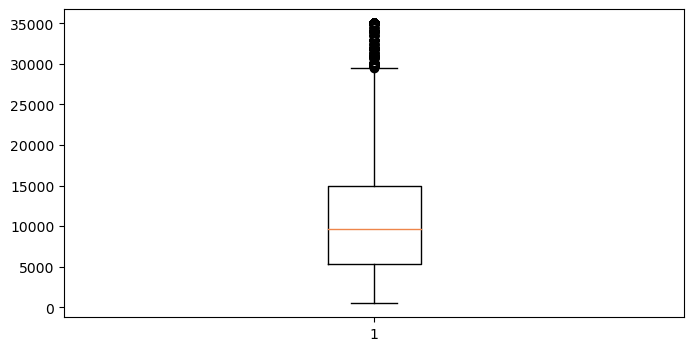

In [56]:
# loan_amnt

plt.figure(figsize=(8,4))

plt.boxplot(loan_data_tobe_considered.loan_amnt)
plt.show

In [57]:
# Checking the quantile info for the loan_amnt column

x = loan_data_tobe_considered["loan_amnt"]

Q1 = x.quantile(0.25)
Q3 = x.quantile(0.75)

IQR = Q3 - Q1

Lower_Fence = Q1 - (1.5 * IQR)
Upper_Fence = Q3 + (1.5 * IQR)


print("Lower Fence : ", min(x[x>Lower_Fence]))
print("Upper Fence : ", max(x[x<Upper_Fence]))


print("Value of 70th quantile : ", x.quantile(0.70))
print("Value of 80th quantile : ", x.quantile(0.80))
print("Value of 85th quantile : ", x.quantile(0.85))
print("Value of 90th quantile : ", x.quantile(0.90))
print("Value of 95th quantile : ", x.quantile(0.95))
print("Value of 96th quantile : ", x.quantile(0.96))
print("Value of 97th quantile : ", x.quantile(0.97))
print("Value of 98th quantile : ", x.quantile(0.98))
print("Value of 99th quantile : ", x.quantile(0.99))

print("Maximum value of the loan_amnt: ", max(x))


Lower Fence :  500
Upper Fence :  29500
Value of 70th quantile :  14000.0
Value of 80th quantile :  16000.0
Value of 85th quantile :  20000.0
Value of 90th quantile :  21600.0
Value of 95th quantile :  25000.0
Value of 96th quantile :  25000.0
Value of 97th quantile :  28000.0
Value of 98th quantile :  30000.0
Value of 99th quantile :  35000.0
Maximum value of the loan_amnt:  35000


* From the above Boxplot we can observe that there are good amount Outliers for "loan_amnt" & "annual_inc". Hence we will remove those data which are more than 95 % Percentile . 

In [58]:
# loan_amnt 


# let  you  want to remove oultliners of loan_amnt in dataframe
x = loan_data_tobe_considered['loan_amnt'].quantile(.95)
loan_data_tobe_considered = loan_data_tobe_considered[loan_data_tobe_considered['loan_amnt'] <= x]

In [59]:
loan_data_tobe_considered.shape

(37092, 23)

<function matplotlib.pyplot.show(close=None, block=None)>

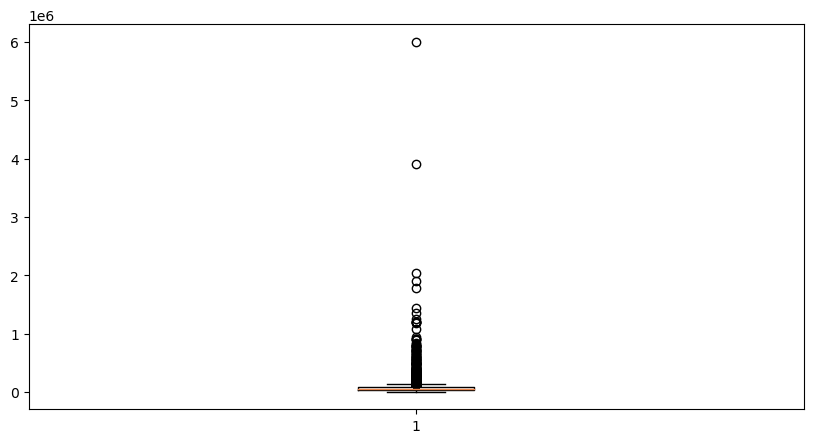

In [60]:
plt.figure(figsize=(10,5))

plt.boxplot(loan_data_tobe_considered.annual_inc)
plt.show

In [61]:
import matplotlib.pyplot as plt
%matplotlib inline

pd.options.display.float_format = '{:.4f}'.format

<function matplotlib.pyplot.show(close=None, block=None)>

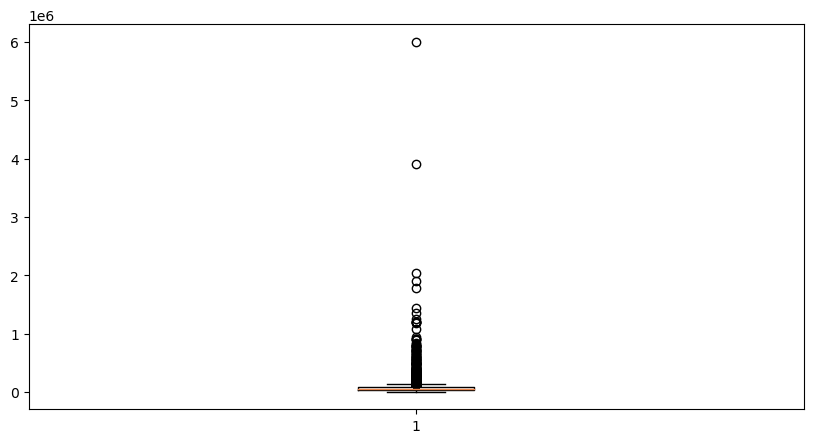

In [62]:
plt.figure(figsize=(10,5))

plt.boxplot(loan_data_tobe_considered.annual_inc)
plt.show

In [63]:
# Checking the quantile info for the annual inc column

x = loan_data_tobe_considered["annual_inc"]

Q1 = x.quantile(0.25)
Q3 = x.quantile(0.75)

IQR = Q3 - Q1

Lower_Fence = Q1 - (1.5 * IQR)
Upper_Fence = Q3 + (1.5 * IQR)


print("Lower Fence : ", min(x[x>Lower_Fence]))
print("Upper Fence : ", max(x[x<Upper_Fence]))


print("Value of 70th quantile : ", x.quantile(0.70))
print("Value of 80th quantile : ", x.quantile(0.80))
print("Value of 85th quantile : ", x.quantile(0.85))
print("Value of 90th quantile : ", x.quantile(0.90))
print("Value of 95th quantile : ", x.quantile(0.95))
print("Value of 96th quantile : ", x.quantile(0.96))
print("Value of 97th quantile : ", x.quantile(0.97))
print("Value of 98th quantile : ", x.quantile(0.98))
print("Value of 99th quantile : ", x.quantile(0.99))

print("Maximum value of the annual_inc: ", max(x))


Lower Fence :  4000.0
Upper Fence :  139992.0
Value of 70th quantile :  75000.0
Value of 80th quantile :  87600.0
Value of 85th quantile :  97000.0
Value of 90th quantile :  110000.0
Value of 95th quantile :  135000.0
Value of 96th quantile :  145000.0
Value of 97th quantile :  157000.0
Value of 98th quantile :  180000.0
Value of 99th quantile :  215059.5799999977
Maximum value of the annual_inc:  6000000.0


* The values after 95th quantile seems to be varying from the general disrtibution and also there is a increase in values for small quantile variation, so consideing threshold of 95th quantile to remove the outliers


In [64]:
# As Box plot shows  that it has good amount of outliers, hence we need to remove those outliers. 
# let  you  want to remove oultliners of annual_inc in dataframe
x = loan_data_tobe_considered['annual_inc'].quantile(.95)
loan_data_tobe_considered = loan_data_tobe_considered[loan_data_tobe_considered['annual_inc'] <= x]

In [65]:
loan_data_tobe_considered.shape

(35242, 23)

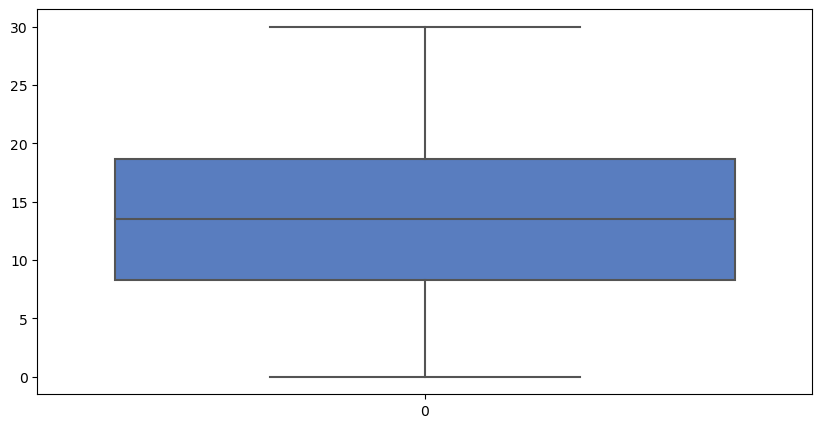

In [66]:
#dti

plt.figure(figsize=(10,5))
sns.boxplot(loan_data_tobe_considered['dti'])
plt.show()


In [67]:
x = loan_data_tobe_considered["dti"]

Q1 = x.quantile(0.25)
Q3 = x.quantile(0.75)

IQR = Q3 - Q1

Lower_Fence = Q1 - (1.5 * IQR)
Upper_Fence = Q3 + (1.5 * IQR)


print("Lower Fence: ", min(x[x>Lower_Fence]))
print("Upper Fence: ", max(x[x<Upper_Fence]))
print("Max value of dti: ", max(x))


Lower Fence:  0.0
Upper Fence:  29.99
Max value of dti:  29.99


* Upper Fence and Lower Fence are same hence we can say there are no Outliers present inside this. So no action needed here on this column.

## Visualizing Categorical Variables -- Univariate Analysis 

#### grade

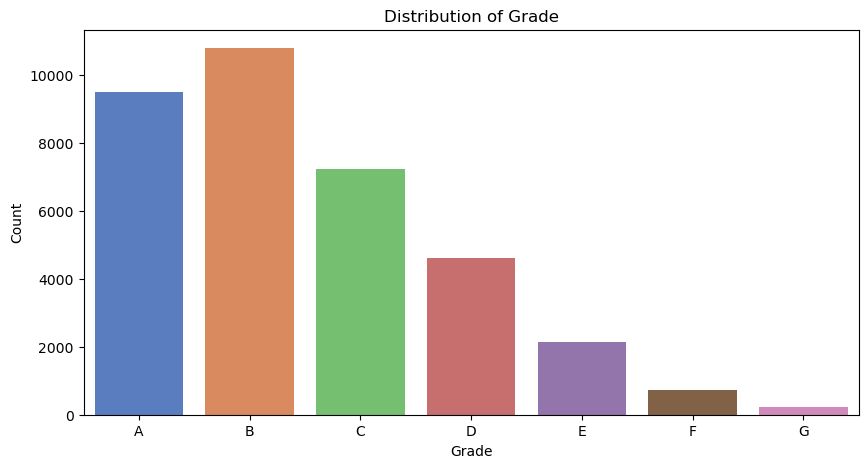

In [68]:
# grade

plt.figure(figsize=(10,5))
sns.countplot(data = loan_data_tobe_considered, x='grade',order = ['A', 'B', 'C', 'D', 'E', 'F', 'G'])
plt.xlabel('Grade')
plt.ylabel('Count')
plt.title('Distribution of Grade')
plt.show()

***Observation:*** The majority of loans fall into categories A & B, suggesting that the predominant type of loans is high-grade loans.

#### loan_status

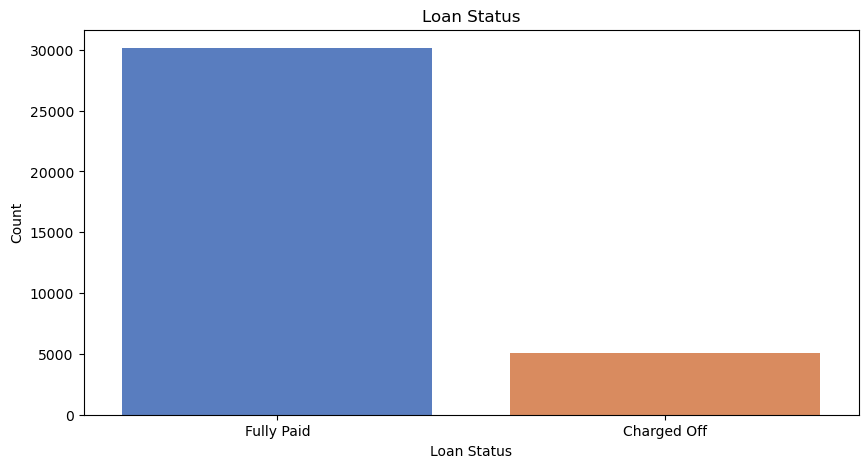

In [69]:
#loan_status

plt.figure(figsize=(10,5))
sns.countplot(data=loan_data_tobe_considered,x='loan_status')
plt.title('Loan Status')
plt.xlabel('Loan Status')
plt.ylabel('Count')
plt.show()

***Observation :*** Fully Paid loans significantly outnumber Defaulted Loans (Charged Off).

#### home_ownership

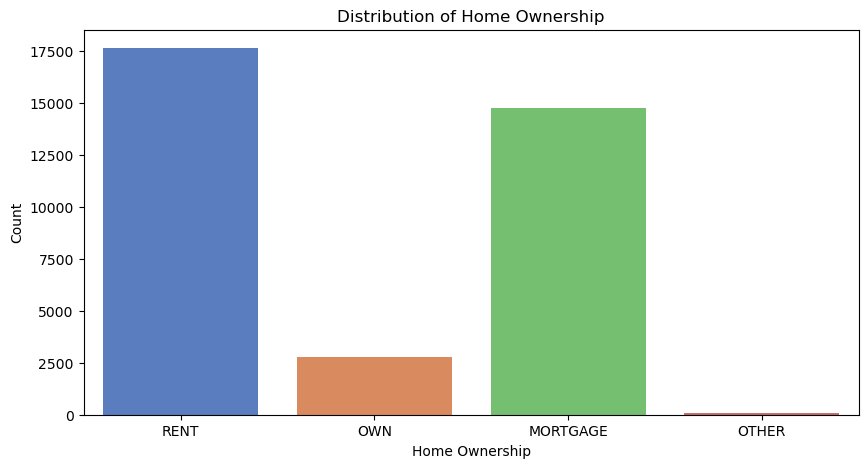

In [70]:
# home_ownership

plt.figure(figsize=(10,5))
sns.countplot(data=loan_data_tobe_considered, x='home_ownership')
plt.xlabel('Home Ownership')
plt.ylabel('Count')
plt.title('Distribution of Home Ownership')
plt.show()

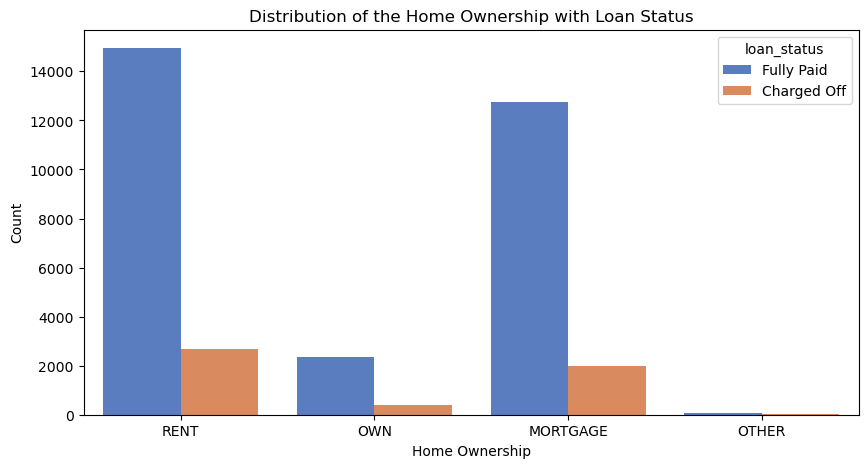

In [71]:
plt.figure(figsize=(10,5))
sns.countplot(data=loan_data_tobe_considered, x='home_ownership', hue='loan_status')
#sns.countplot(data = loan_data[loan_data['loan_status'] == 'Charged Off'], x='home_ownership')
plt.xlabel('Home Ownership')
plt.ylabel('Count')
plt.title('Distribution of the Home Ownership with Loan Status')
plt.show()

***Observation :*** The majority of borrowers do not own any property and are either renting or have a mortgage. The percentage of loan defaulters is higher among borrowers with an existing "MORTGAGE."

#### verification_status 

In [72]:
# verification_status 

loan_data_tobe_considered['verification_status'].value_counts()

Not Verified       16181
Verified           10134
Source Verified     8927
Name: verification_status, dtype: int64

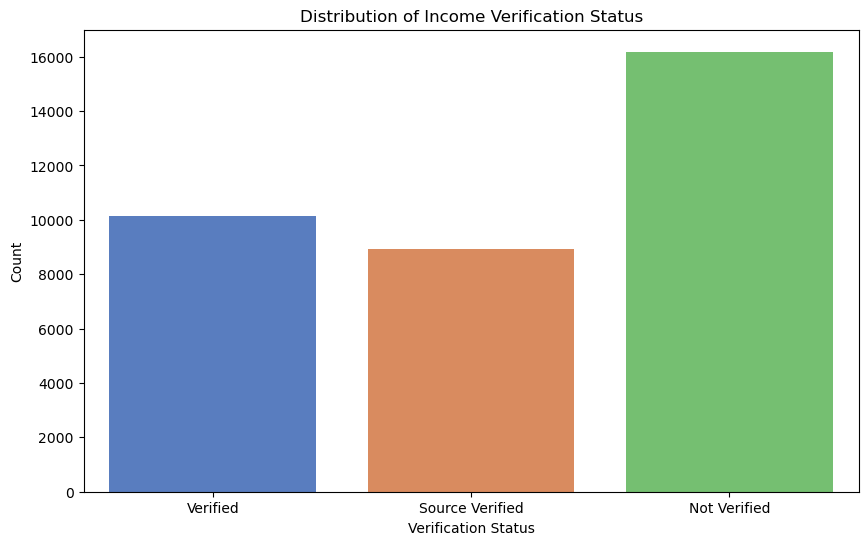

In [73]:
# verification_status

plt.figure(figsize=(10,6))
sns.countplot(data=loan_data_tobe_considered, x='verification_status')
plt.xlabel('Verification Status')
plt.ylabel('Count')
plt.title('Distribution of Income Verification Status')
plt.show()


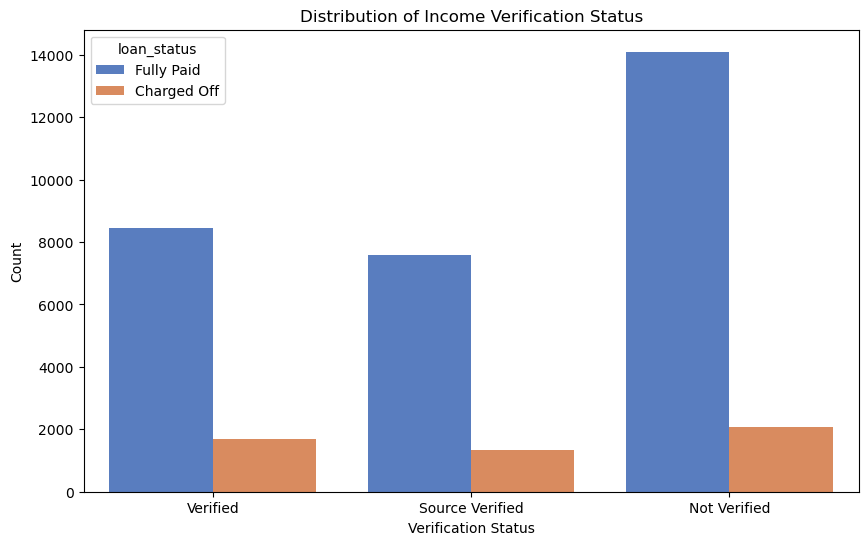

In [74]:
# verification_status

plt.figure(figsize=(10,6))
sns.countplot(data=loan_data_tobe_considered, x='verification_status', hue='loan_status')
plt.xlabel('Verification Status')
plt.ylabel('Count')
plt.title('Distribution of Income Verification Status')
plt.show()

***Observation :*** For Most of the borrowers the income status is not verified by consumer Finance Company.

#### purpose

In [75]:
#purpose

loan_data_tobe_considered['purpose'].value_counts()

debt_consolidation    16510
credit_card            4614
other                  3621
home_improvement       2426
major_purchase         2001
small_business         1506
car                    1437
wedding                 874
medical                 632
moving                  537
vacation                362
house                   320
educational             309
renewable_energy         93
Name: purpose, dtype: int64

In [76]:
loan_data_tobe_considered['purpose'].unique()

array(['credit_card', 'car', 'small_business', 'other', 'wedding',
       'debt_consolidation', 'home_improvement', 'major_purchase',
       'medical', 'moving', 'vacation', 'house', 'renewable_energy',
       'educational'], dtype=object)

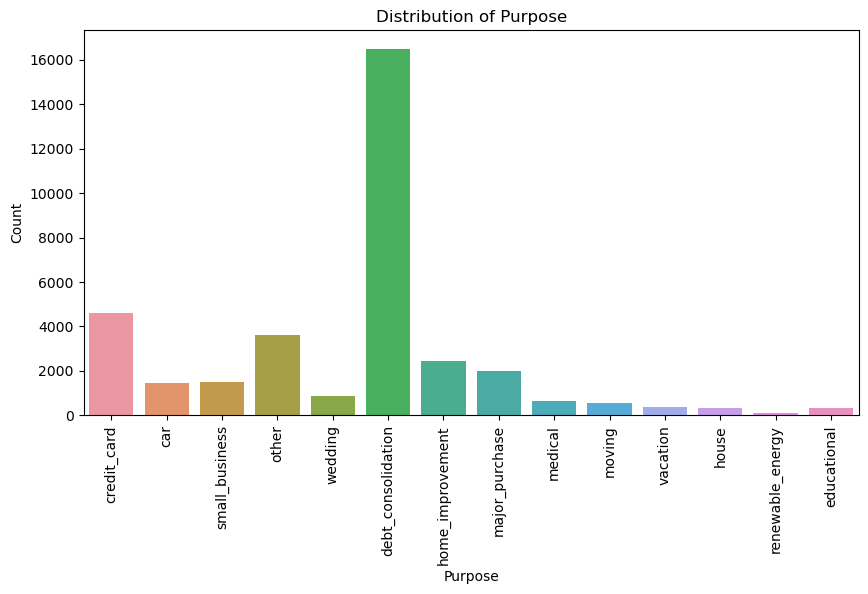

In [77]:
# verification_status
plt.figure(figsize=(10,5))
sns.countplot(data=loan_data_tobe_considered, x='purpose')
plt.xticks(rotation='vertical')
plt.xlabel('Purpose')
plt.ylabel('Count')
plt.title('Distribution of Purpose')
plt.show()


***Observation :*** The primary reason for borrowers taking out loans is debt consolidation, with credit card usage as the second most common purpose.

#### emp_length

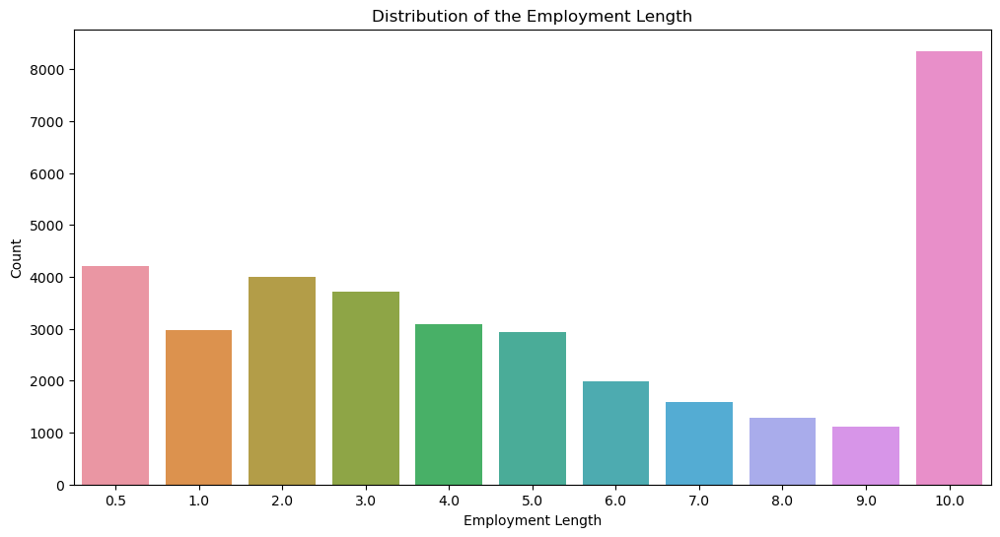

In [78]:
# emp_length
plt.figure(figsize=(12,6))
sns.countplot(data=loan_data_tobe_considered, x='emp_length')
plt.xlabel('Employment Length')
plt.ylabel('Count')
plt.title('Distribution of the Employment Length')
plt.show()

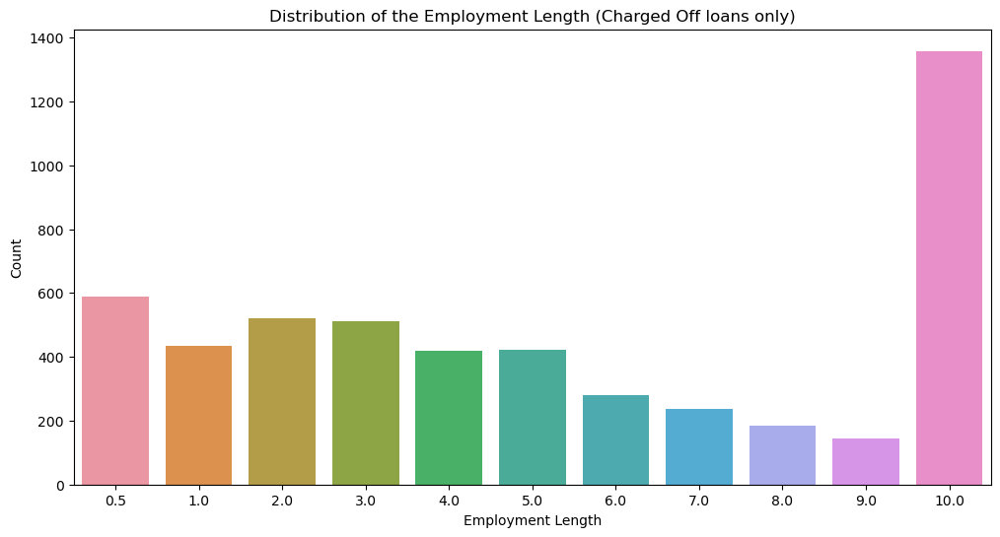

In [79]:
# emp_length for only "Charged Off" loans.
plt.figure(figsize=(12,6))
sns.countplot(x='emp_length', data=loan_data_tobe_considered[loan_data_tobe_considered.loan_status == 'Charged Off'])
plt.xlabel('Employment Length')
plt.ylabel('Count')
plt.title('Distribution of the Employment Length (Charged Off loans only)')
plt.show()

***Observation :*** 

Most of the borrowers are having experience of 10+ years With consumer Finance Company.

Most of the defaulters are having experience of 10+ years With consumer Finance Company. 

#### Address State

In [80]:
#addr_state

loan_data_tobe_considered['addr_state'].unique()


array(['AZ', 'GA', 'IL', 'CA', 'NC', 'TX', 'VA', 'MO', 'CT', 'UT', 'FL',
       'NY', 'PA', 'MN', 'OR', 'KY', 'OH', 'SC', 'NJ', 'RI', 'LA', 'MA',
       'WA', 'WI', 'AL', 'NV', 'AK', 'CO', 'MD', 'WV', 'VT', 'MI', 'DC',
       'SD', 'NH', 'AR', 'KS', 'NM', 'HI', 'OK', 'MT', 'DE', 'WY', 'MS',
       'IA', 'TN', 'NE', 'ID', 'IN', 'ME'], dtype=object)

In [81]:
loan_data_tobe_considered['addr_state'].value_counts()

CA    6310
NY    3359
FL    2568
TX    2366
NJ    1594
PA    1376
IL    1350
VA    1258
GA    1232
MA    1176
OH    1099
MD     926
AZ     780
WA     758
CO     709
NC     681
MI     653
CT     640
MO     626
MN     566
NV     439
SC     423
OR     419
WI     403
AL     401
LA     386
KY     292
OK     272
KS     234
UT     228
AR     221
RI     184
DC     183
NM     170
WV     160
HI     152
NH     146
DE     106
MT      79
WY      77
AK      67
SD      60
VT      51
MS      19
TN      16
IN       9
IA       5
NE       5
ID       5
ME       3
Name: addr_state, dtype: int64

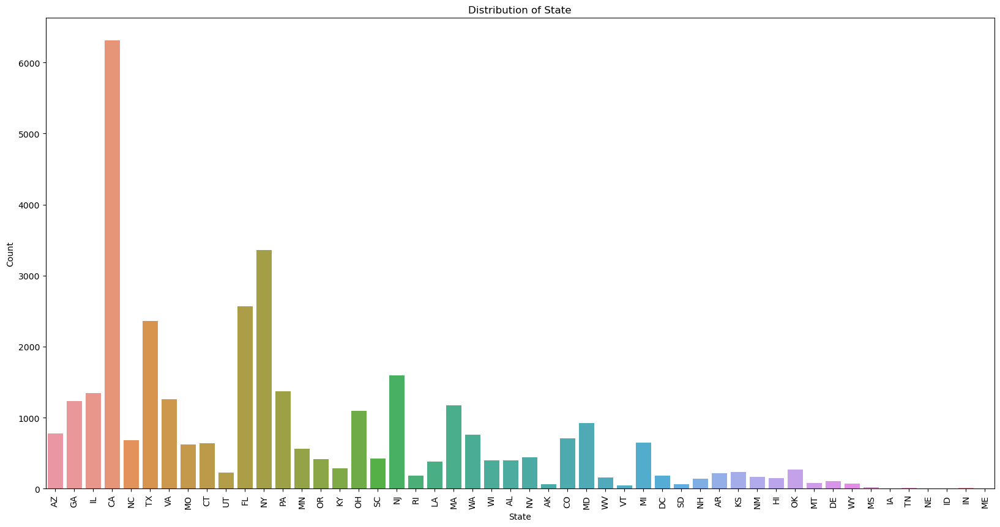

In [82]:
plt.figure(figsize=(20,10))
sns.countplot(data=loan_data_tobe_considered,x='addr_state')
plt.xticks(rotation='vertical')
plt.xlabel('State')
plt.ylabel('Count')
plt.title('Distribution of State')
plt.show()


#### Adressing the Realtion b/w add_State and  loan_Status

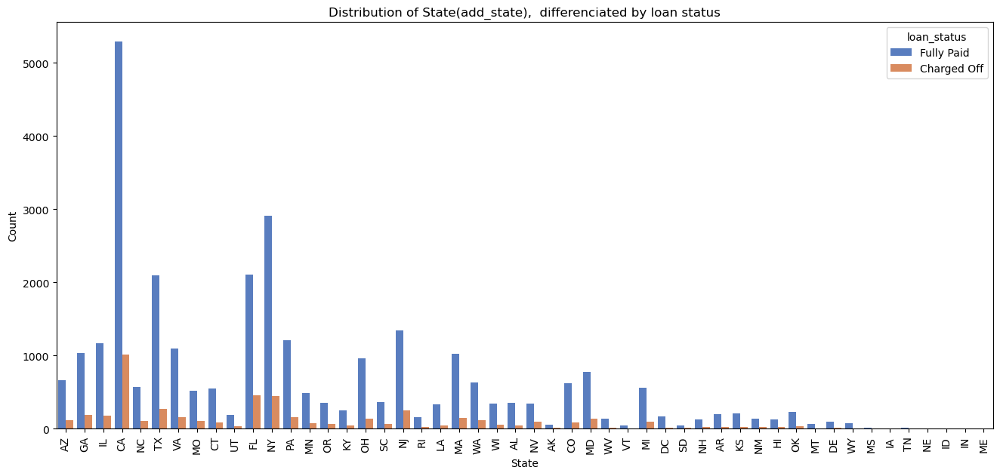

In [83]:
plt.figure(figsize=(16,7))
sns.countplot(data=loan_data_tobe_considered,x='addr_state',hue='loan_status')
plt.xticks(rotation='vertical')
plt.xlabel('State')
plt.ylabel('Count')
plt.title('Distribution of State(add_state),  differenciated by loan status')
plt.show()

***Observation :*** The graph clearly shows that majority of the borrowers are from Big Cities like California, NewYork, Florida, New Jersey, Texas etc. 

#### Number of Public Record Bankruptcies

In [84]:
loan_data_tobe_considered['pub_rec_bankruptcies'].value_counts()

0.0000    33673
1.0000     1564
2.0000        5
Name: pub_rec_bankruptcies, dtype: int64

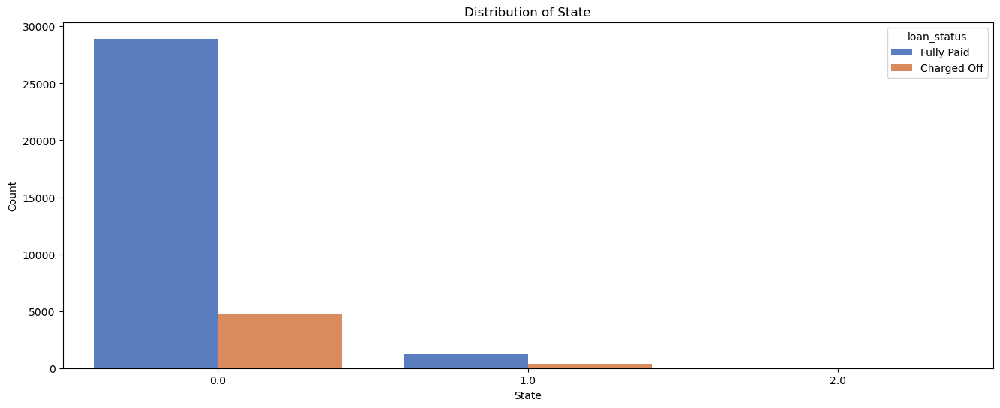

In [85]:
plt.figure(figsize=(16,6))
sns.countplot(data=loan_data_tobe_considered, x='pub_rec_bankruptcies',hue='loan_status')
plt.xlabel('State')
plt.ylabel('Count')
plt.title('Distribution of State')
plt.show()


***Observation :*** Based on the numerical data, it is clear that the majority of borrowers have a public record of "zero" bankruptcies.

#### Term

In [86]:
loan_data_tobe_considered['term'].value_counts()

 36 months    27214
 60 months     8028
Name: term, dtype: int64

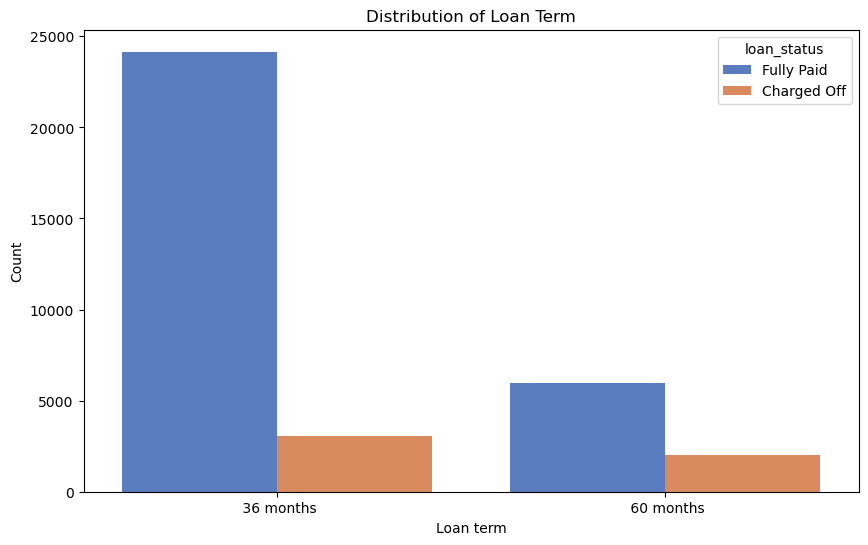

In [87]:
#term
plt.figure(figsize=(10,6))
sns.countplot(data=loan_data_tobe_considered, x='term',hue='loan_status')
plt.xlabel('Loan term')
plt.ylabel('Count')
plt.title('Distribution of Loan Term')
plt.show()

***Observation :*** Majority of the loans are approved for a period of 36 months.

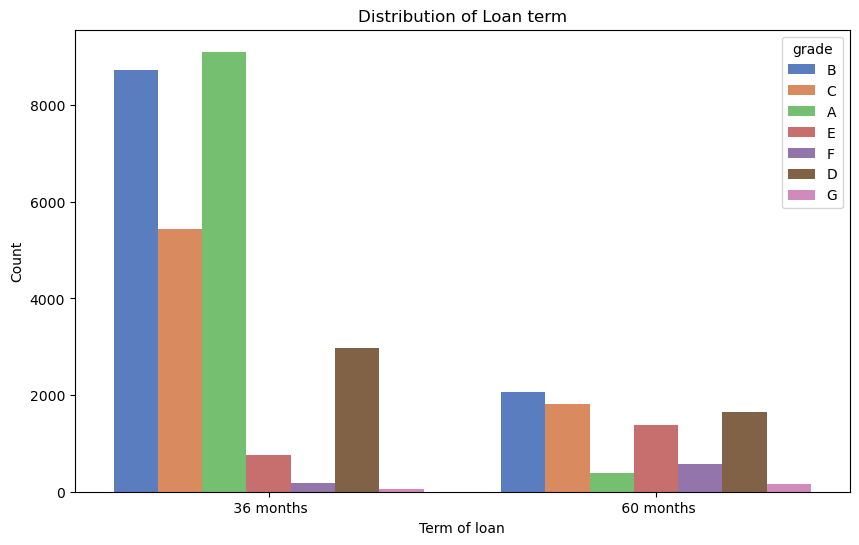

In [88]:
plt.figure(figsize=(10,6))
sns.countplot(data=loan_data_tobe_considered, x='term', hue='grade')
plt.xlabel('Term of loan')
plt.ylabel('Count')
plt.title('Distribution of Loan term')
plt.show()

***Observation :*** The majority of 36-month loans are in grade A and B, while the majority of 60-month loans belong to grade B and C.

#### Inquiry in last 6 months

In [89]:
# inq_last_6mths

loan_data_tobe_considered['inq_last_6mths'].value_counts()

0    17182
1     9735
2     5143
3     2695
4      272
5      125
6       50
7       30
8       10
Name: inq_last_6mths, dtype: int64

In [90]:
loan_data_tobe_considered['inq_last_6mths'].unique()

array([1, 5, 2, 3, 0, 4, 6, 7, 8])

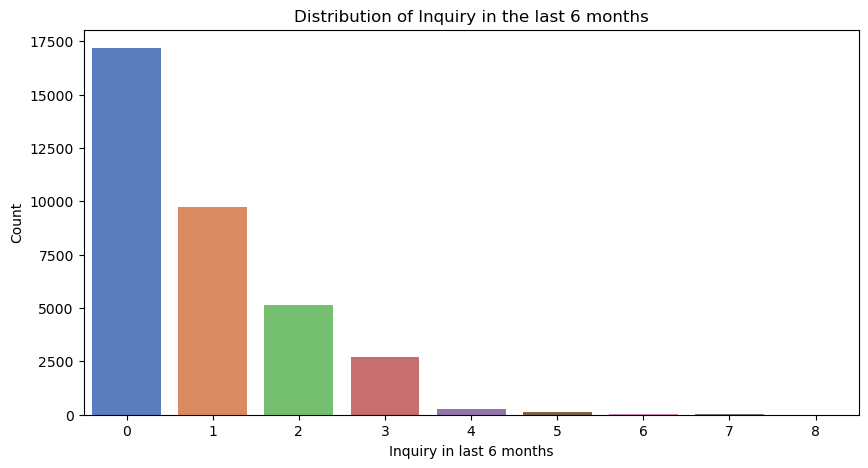

In [91]:
#inq_last_6mths

plt.figure(figsize=(10,5))
sns.countplot(data=loan_data_tobe_considered, x='inq_last_6mths')
plt.xlabel('Inquiry in last 6 months')
plt.ylabel('Count')
plt.title('Distribution of Inquiry in the last 6 months')
plt.show()


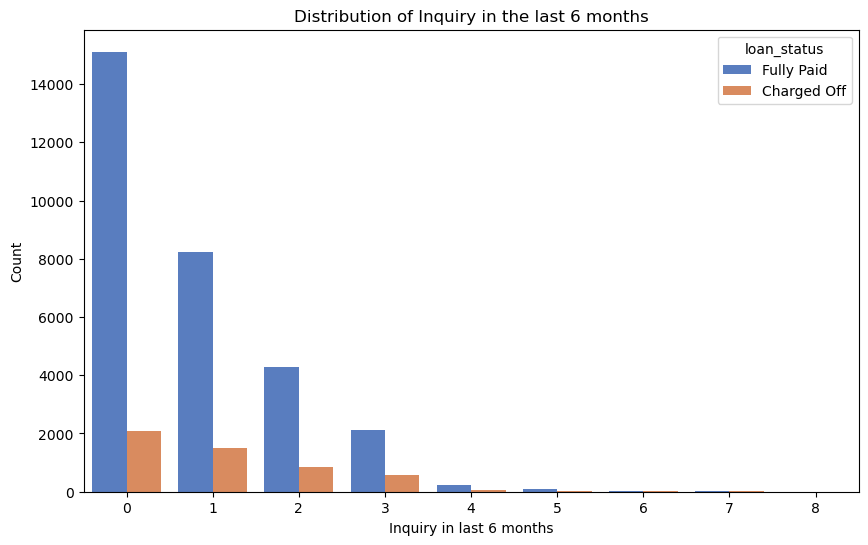

In [92]:
#inq_last_6mths

plt.figure(figsize=(10,6))
sns.countplot(data=loan_data_tobe_considered, x='inq_last_6mths', hue='loan_status')
plt.xlabel('Inquiry in last 6 months')
plt.ylabel('Count')
plt.title('Distribution of Inquiry in the last 6 months')
plt.show()


#### Annual Income

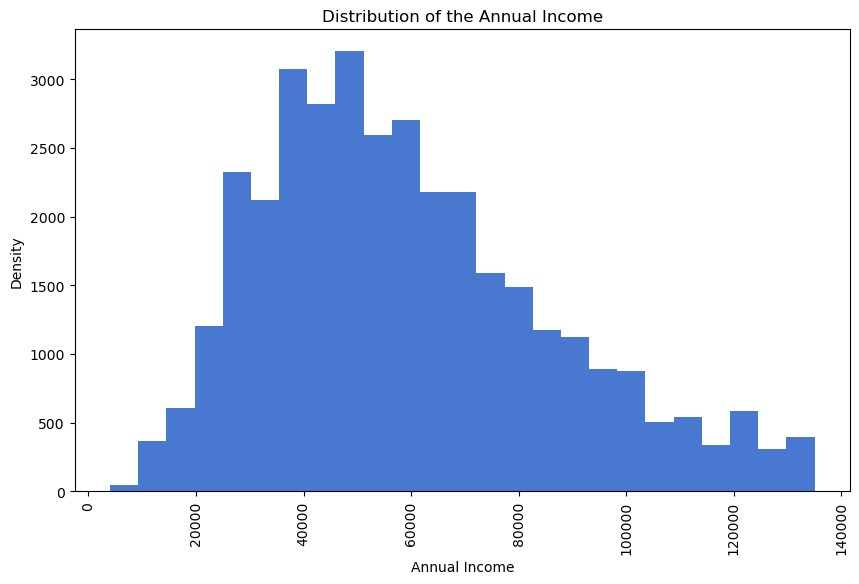

In [93]:
# Distribution of annual_inc

plt.figure(figsize=(10,6))
plt.hist(loan_data_tobe_considered["annual_inc"],bins=25)
plt.xticks(rotation='vertical')
plt.xlabel('Annual Income')
plt.ylabel('Density')
plt.title('Distribution of the Annual Income')
plt.show()

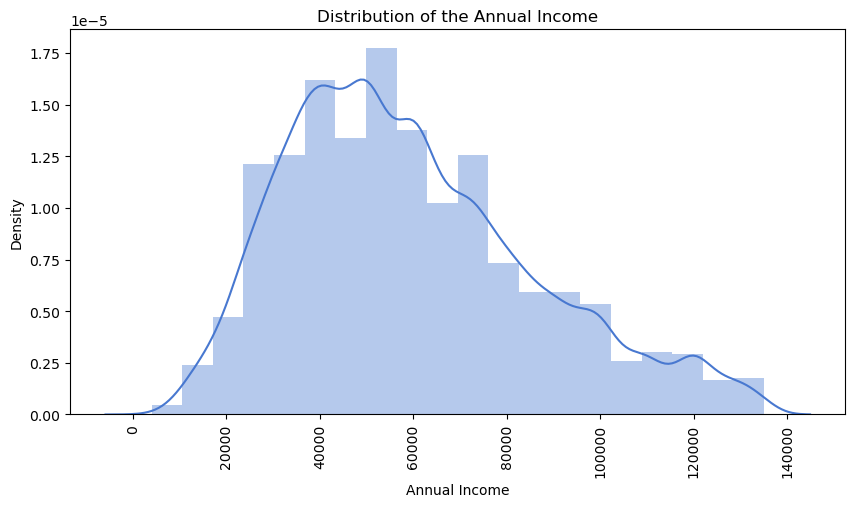

In [94]:
# Distribution of annual_inc
plt.figure(figsize=(10,5))
sns.distplot(loan_data_tobe_considered["annual_inc"],kde=True,bins=20)
plt.xticks(rotation='vertical')
plt.xlabel('Annual Income')
plt.ylabel('Density')
plt.title('Distribution of the Annual Income')
plt.show()

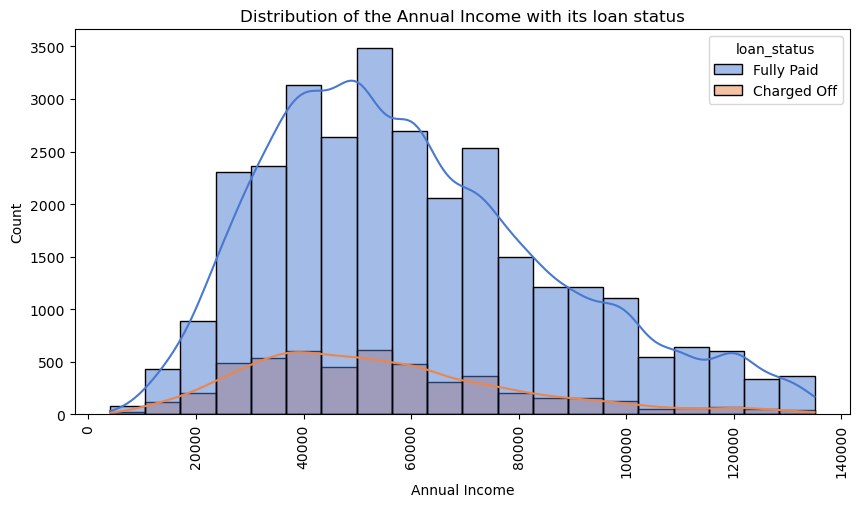

In [95]:
# Distribution of annual_inc
plt.figure(figsize=(10,5))
sns.histplot(data=loan_data_tobe_considered, x="annual_inc",hue='loan_status',kde=True,bins=20)
plt.xticks(rotation='vertical')
plt.xlabel('Annual Income')
plt.ylabel('Count')
plt.title('Distribution of the Annual Income with its loan status')
plt.show()

***Observation :*** The distribution of Annual Income exhibits characteristics of a left-skewed normal distribution, indicating that the majority of borrowers have relatively low annual incomes. Borrowers with annual incomes below $50,000 are at a higher likelihood of loan default.


#### dti: debt to income ratio

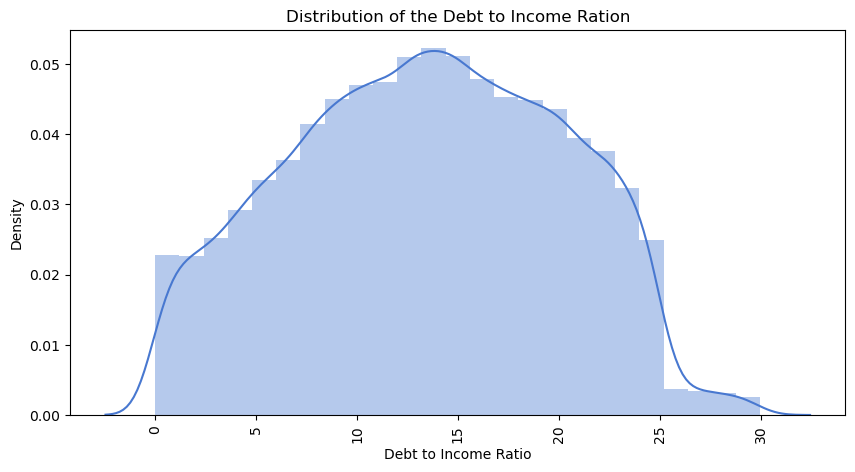

In [96]:
# dti

plt.figure(figsize=(10,5))
sns.distplot(loan_data_tobe_considered['dti'],kde=True,bins=25)
plt.xticks(rotation='vertical')
plt.xlabel('Debt to Income Ratio')
plt.ylabel('Density')
plt.title('Distribution of the Debt to Income Ration')
plt.show()


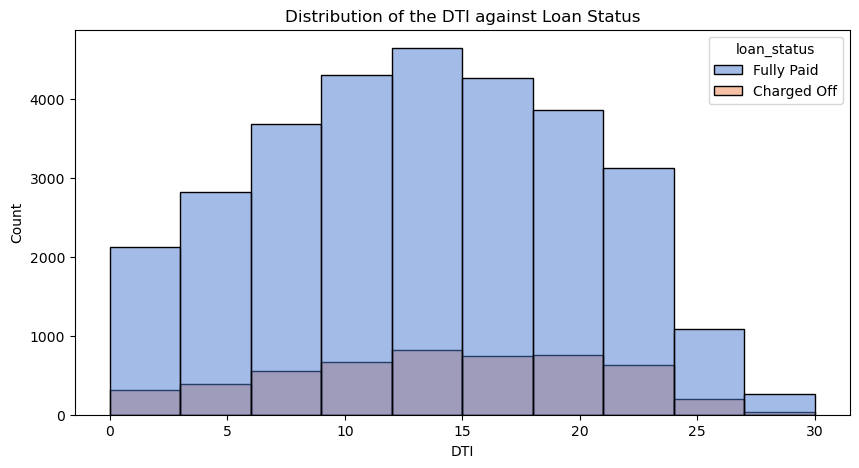

In [97]:
plt.figure(figsize=(10,5))
sns.histplot(x=loan_data_tobe_considered['dti'],hue=loan_data_tobe_considered['loan_status'],bins=10)
plt.xlabel('DTI')
plt.ylabel('Count')
plt.title('Distribution of the DTI against Loan Status')
plt.show()

***Observation :*** Analyzing the distribution, it is evident that a significant proportion of borrowers have a notably high debt-to-income ratio, primarily clustered within the 10-20 DTI ratio range.

#### Analyzing "Loan Amount" Vs "Loan Status".

In [98]:
loan_data_tobe_considered.head(2)

,loan_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_util,total_acc,pub_rec_bankruptcies
0,5000,4975.0000,36 months,10.6500,162.8700,B,B2,10.0000,RENT,24000.0000,Verified,Dec-11,Fully Paid,credit_card,AZ,27.6500,Jan-85,1,3,0,83.7000,9,0.0000
1,2500,2500.0000,60 months,15.2700,59.8300,C,C4,0.5000,RENT,30000.0000,Source Verified,Dec-11,Charged Off,car,GA,1.0000,Apr-99,5,3,0,9.4000,4,0.0000


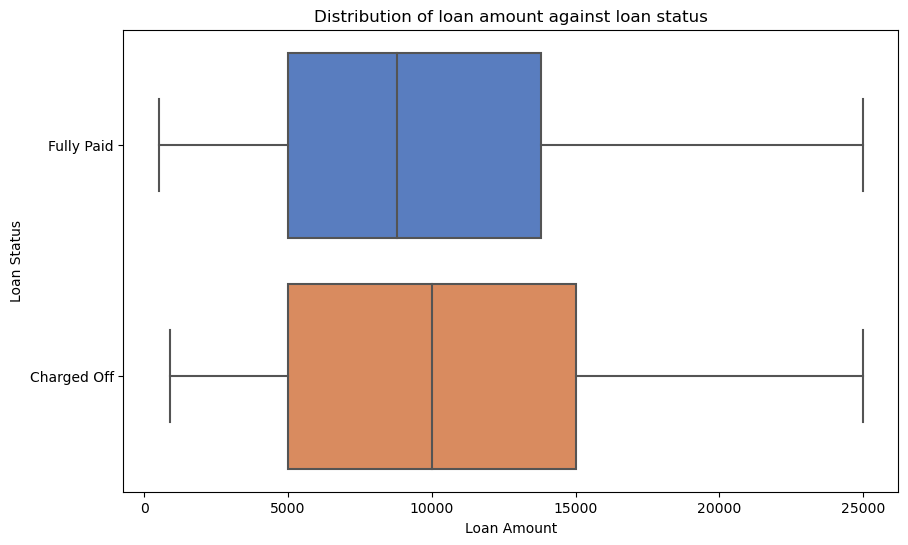

In [99]:
# Distribution of loan amount based on loan status

plt.figure(figsize=(10,6))
sns.boxplot(data=loan_data_tobe_considered, x='loan_amnt', y='loan_status')
plt.xlabel("Loan Amount")
plt.ylabel("Loan Status")
plt.title("Distribution of loan amount against loan status")
plt.show()

***Observation :*** 

The mean & 25th quantile is same for both Fully Paid and Charged Off loans.


#### Analyzing "Purpose" Vs "Annual Income".

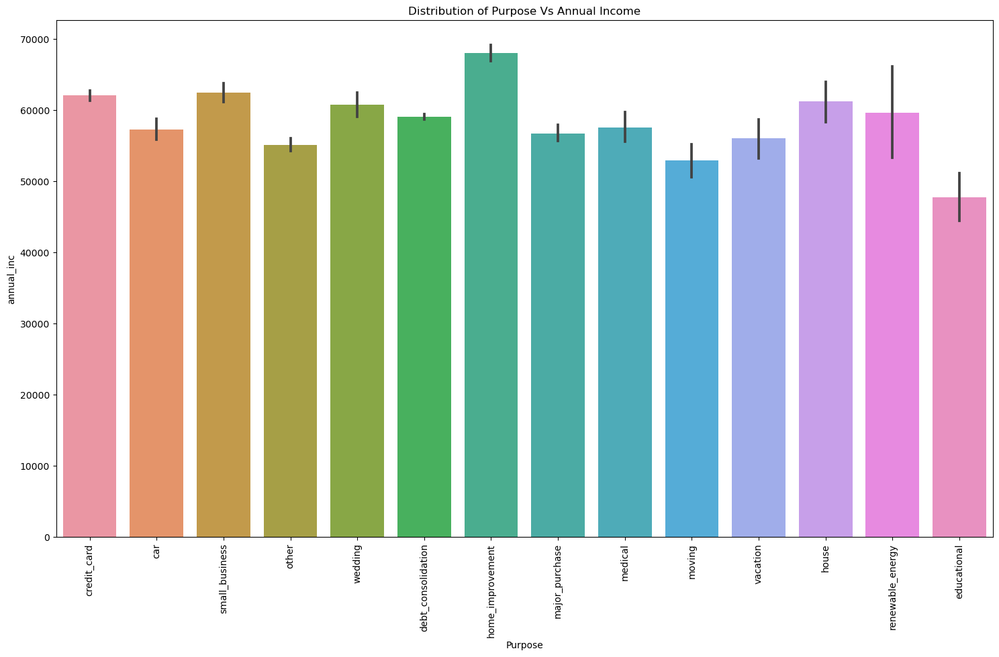

In [100]:
plt.figure(figsize=(18,10))
sns.barplot(data=loan_data_tobe_considered,x='purpose',y='annual_inc')
plt.xticks(rotation='vertical')
plt.xlabel('Purpose')
plt.title('Distribution of Purpose Vs Annual Income')
plt.show()

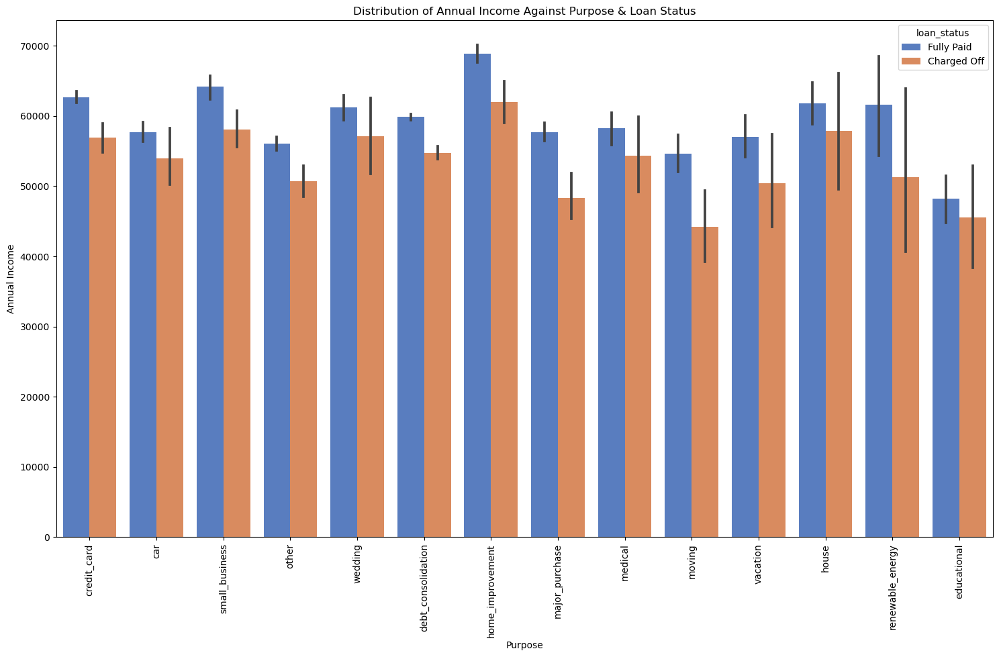

In [101]:
plt.figure(figsize=(18,10))
sns.barplot(data=loan_data_tobe_considered,x='purpose',y='annual_inc', hue='loan_status')
plt.xticks(rotation='vertical')
plt.xlabel('Purpose')
plt.ylabel('Annual Income')
plt.title('Distribution of Annual Income Against Purpose & Loan Status')
plt.show()

***Observation :***

Individuals with higher incomes predominantly sought loans for purposes such as home improvement, small business ventures, and credit card debt consolidation.

The highest number of loan defaults is observed in categories related to debt consolidation, small business loans, credit card loans, and home improvement loans.


#### Analyzing Annual Income column against home ownership

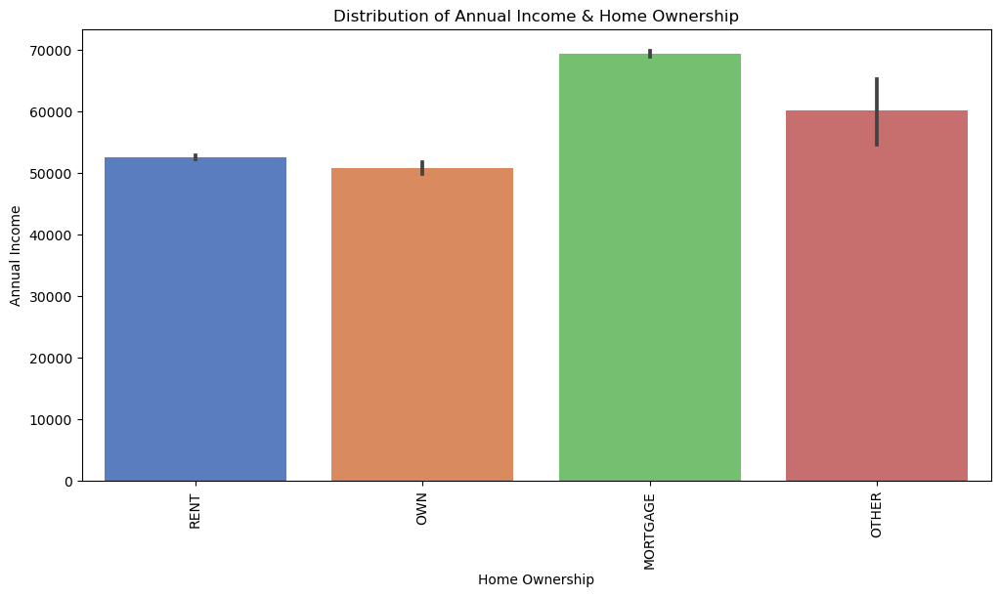

In [102]:
plt.figure(figsize=(12,6))
sns.barplot(data=loan_data_tobe_considered,x='home_ownership',y='annual_inc')
plt.xticks(rotation='vertical')
plt.xlabel('Home Ownership')
plt.ylabel('Annual Income')
plt.title('Distribution of Annual Income & Home Ownership')
plt.show()

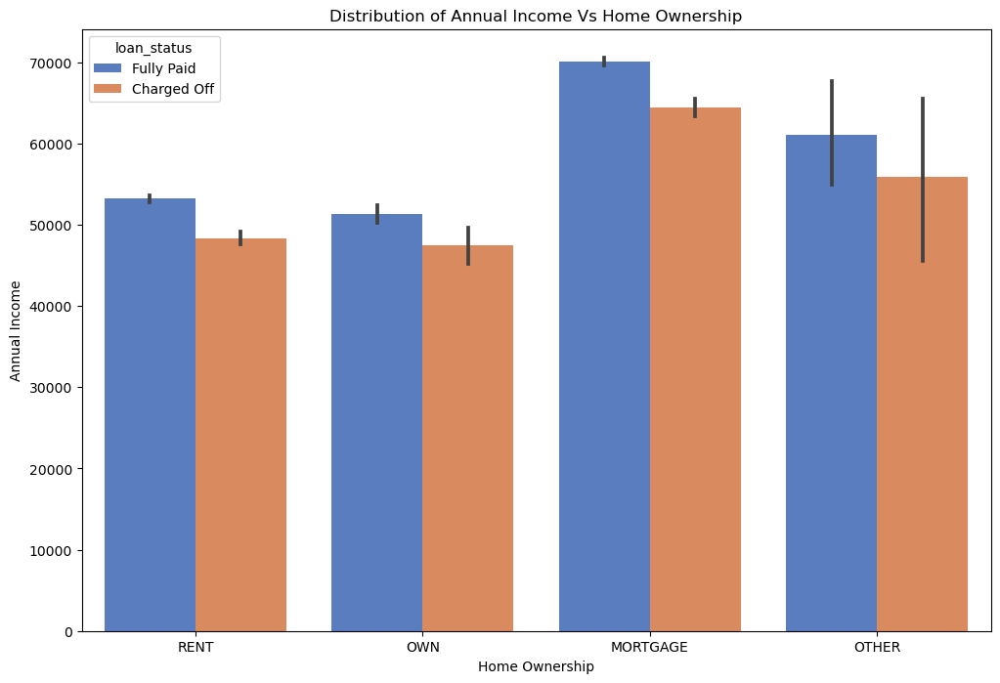

In [103]:
plt.figure(figsize=(12,8))
sns.barplot(data=loan_data_tobe_considered,x='home_ownership',y='annual_inc', hue = 'loan_status')
plt.xlabel('Home Ownership')
plt.ylabel('Annual Income')
plt.title('Distribution of Annual Income Vs Home Ownership')
plt.show()

#### Analyzing Loan Amount Vs Purpose.

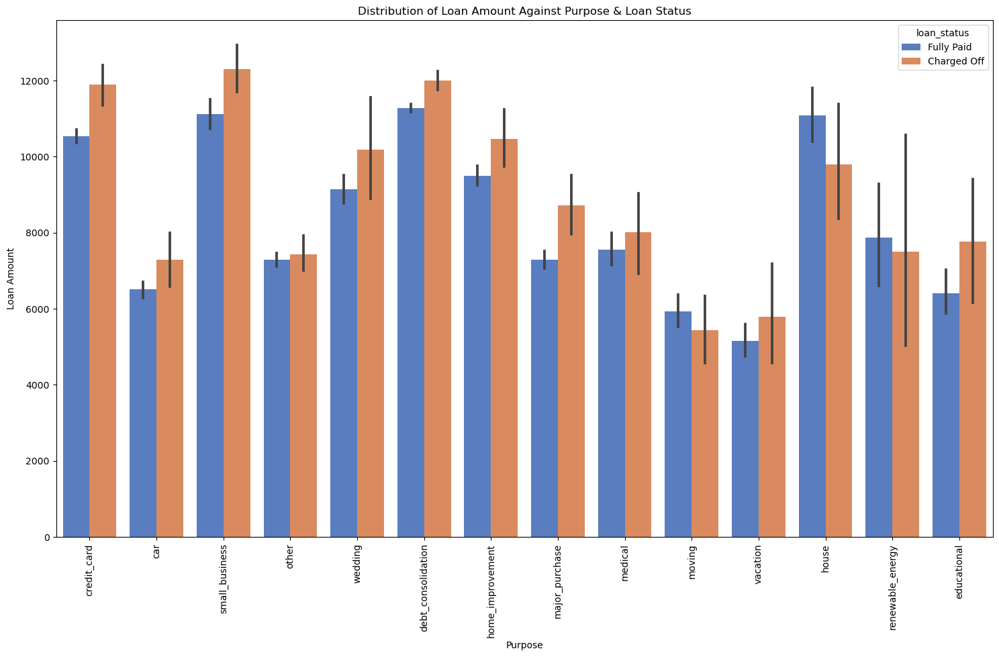

In [104]:
plt.figure(figsize=(18,10))
sns.barplot(data=loan_data_tobe_considered,x='purpose',y='loan_amnt',hue='loan_status')
plt.xticks(rotation='vertical')
plt.xlabel('Purpose')
plt.ylabel('Loan Amount')
plt.title('Distribution of Loan Amount Against Purpose & Loan Status')
plt.show()


#### Analyzing Loan Amount Vs Grade.

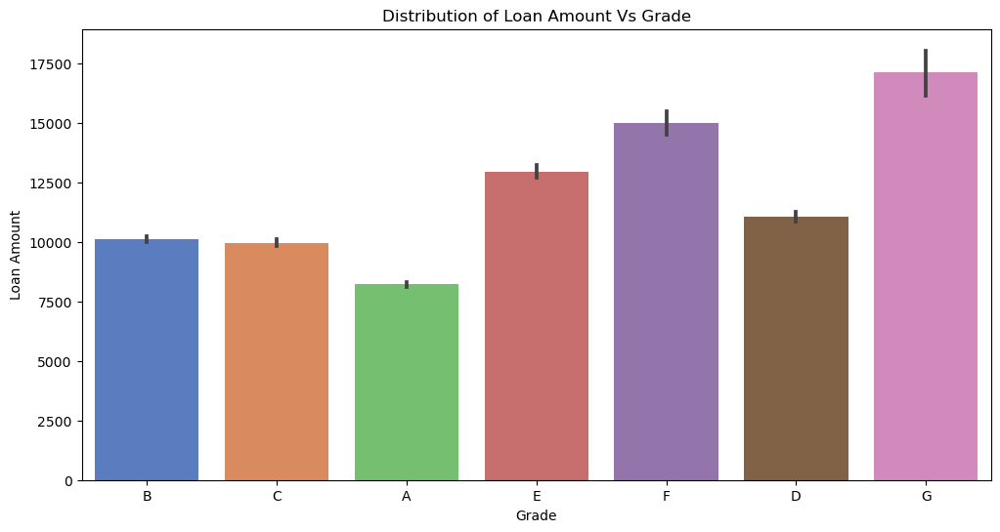

In [105]:
plt.figure(figsize=(12,6))
sns.barplot(data=loan_data_tobe_considered,x='grade',y='loan_amnt')
plt.xlabel('Grade')
plt.ylabel('Loan Amount')
plt.title('Distribution of Loan Amount Vs Grade')
plt.show()

#### Analyzing Loan Amount Against Grade & Loan Status

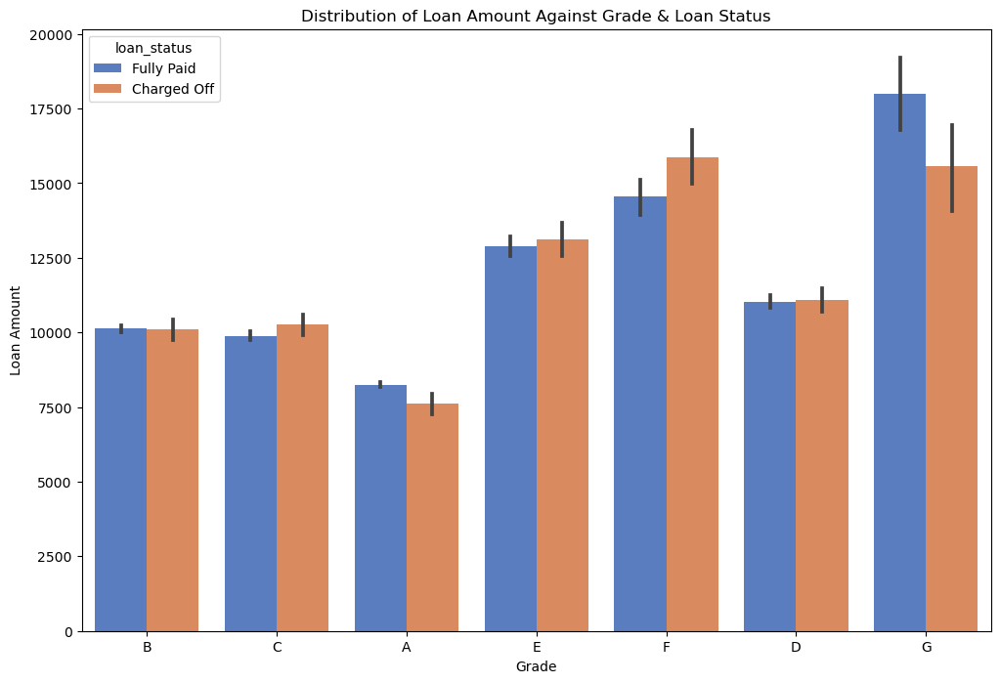

In [106]:
plt.figure(figsize=(12,8))
sns.barplot(data=loan_data_tobe_considered,x='grade',y='loan_amnt',hue='loan_status')
plt.xlabel('Grade')
plt.ylabel('Loan Amount')
plt.title('Distribution of Loan Amount Against Grade & Loan Status')
plt.show()

#### Loan Amount Against House Ownership , Loan Status .

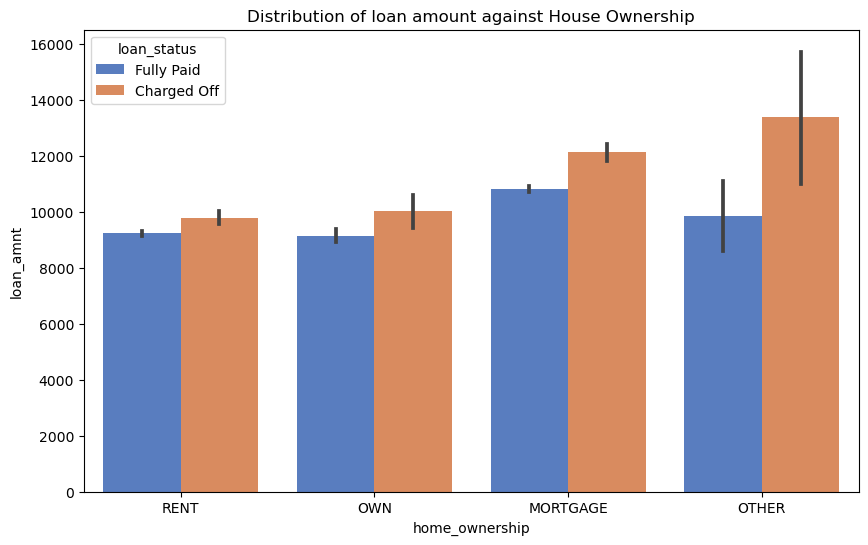

In [107]:
plt.figure(figsize=(10,6))
sns.barplot(data =loan_data_tobe_considered,x='home_ownership', y='loan_amnt', hue ='loan_status')
plt.title("Distribution of loan amount against House Ownership")
plt.show()


#### Loan against Employment Length

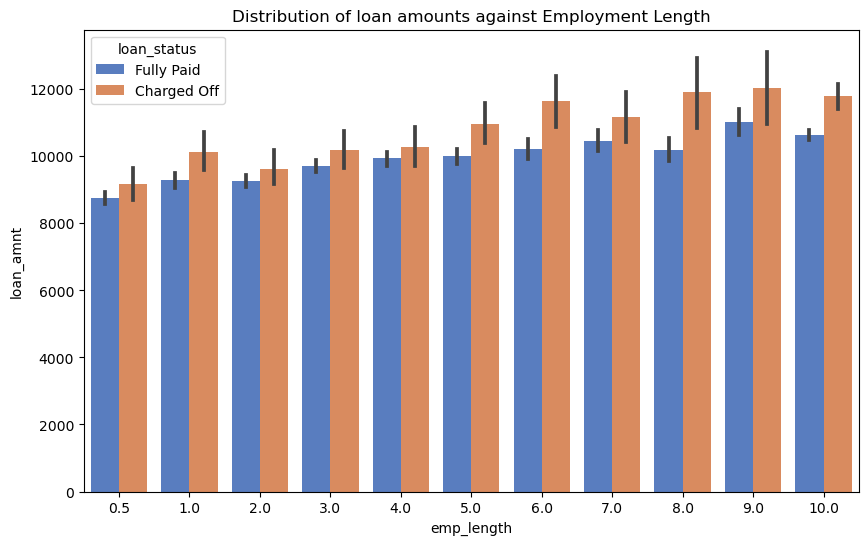

In [108]:
plt.figure(figsize=(10,6))
sns.barplot(data =loan_data_tobe_considered,y='loan_amnt', x='emp_length', hue ='loan_status')
plt.title("Distribution of loan amounts against Employment Length")
plt.show()

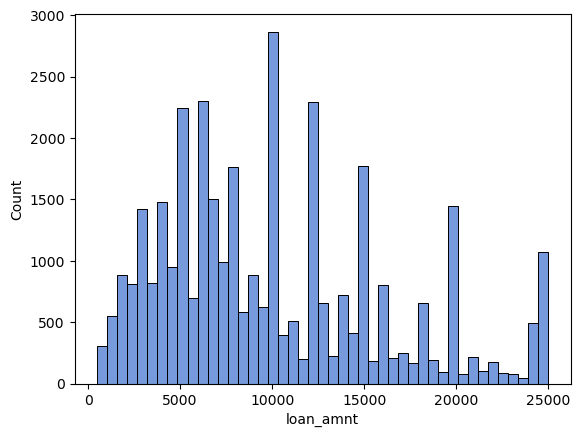

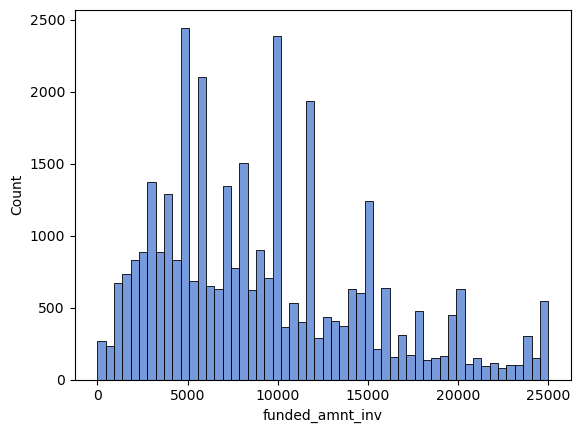

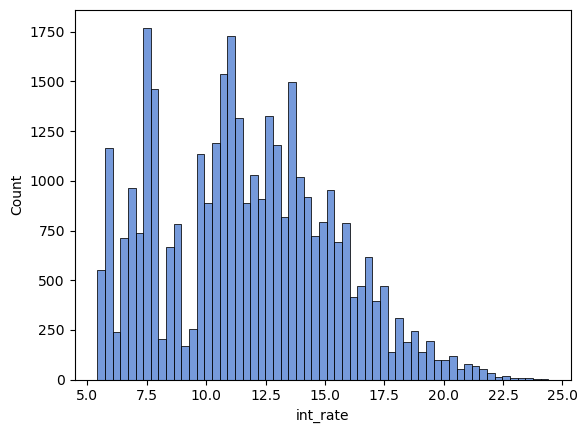

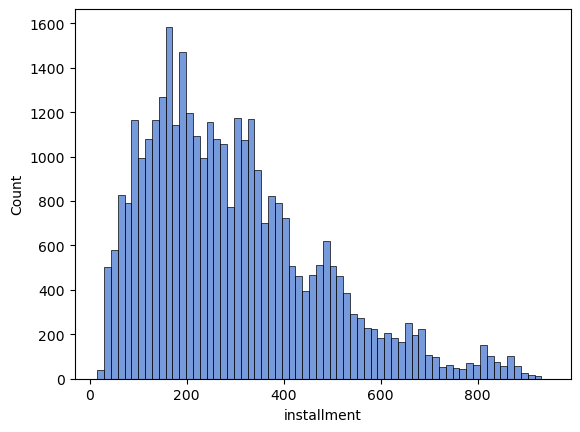

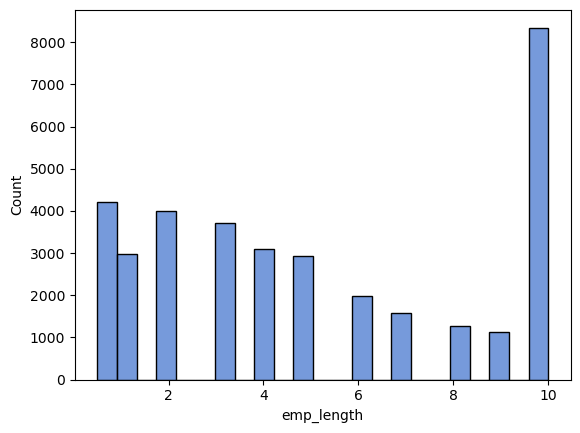

...

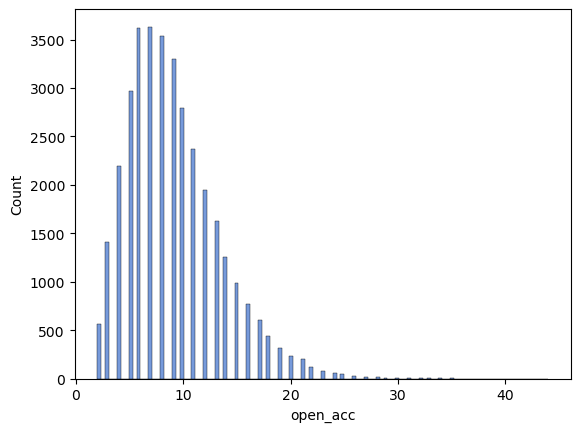

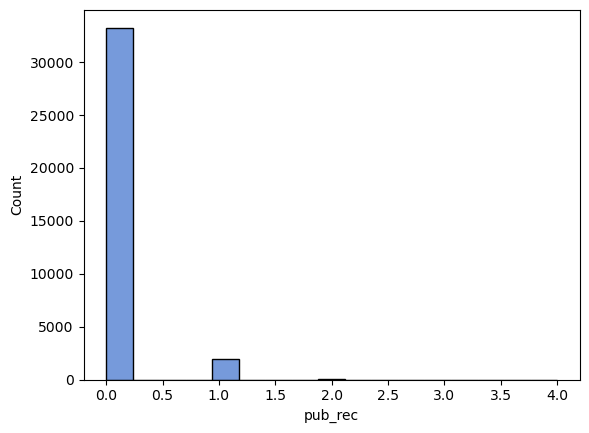

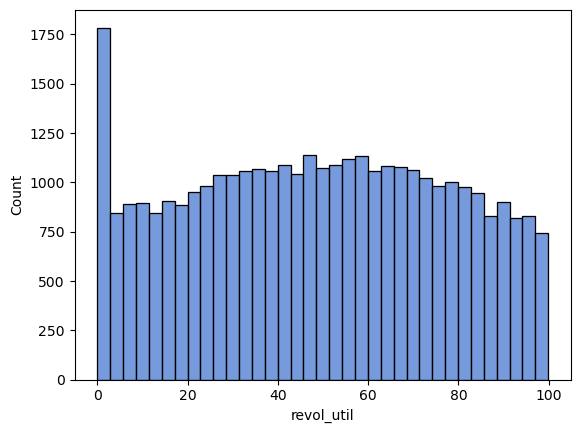

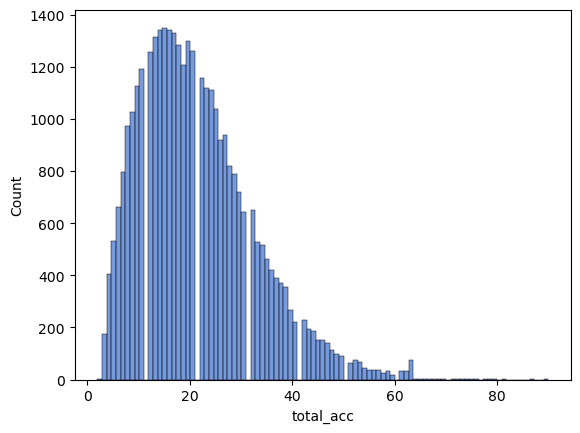

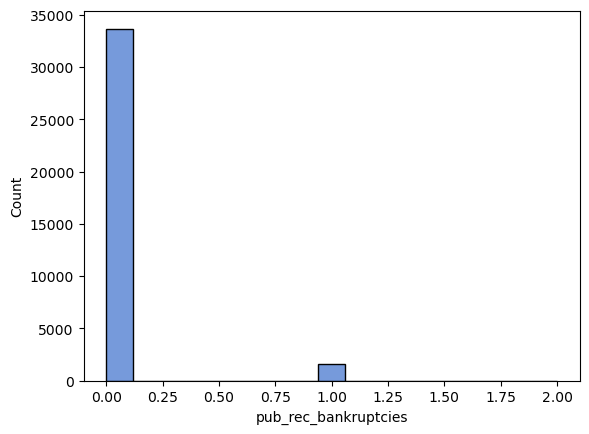

In [109]:
# Creating UniVariate graphs for Contineous/Numerical Columns :- 
for col in cont_cols :
    sns.histplot(x = loan_data_tobe_considered[col])
    plt.show()

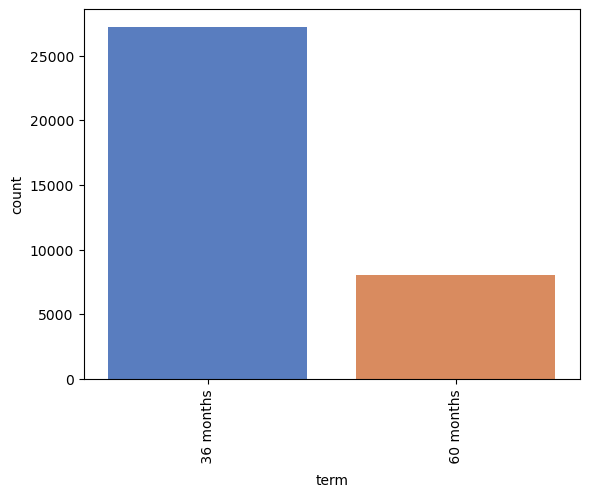

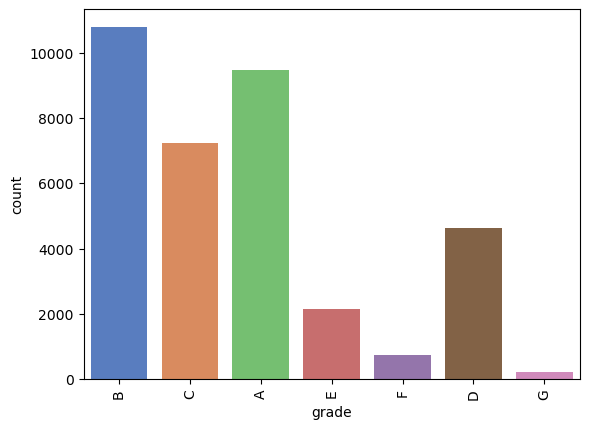

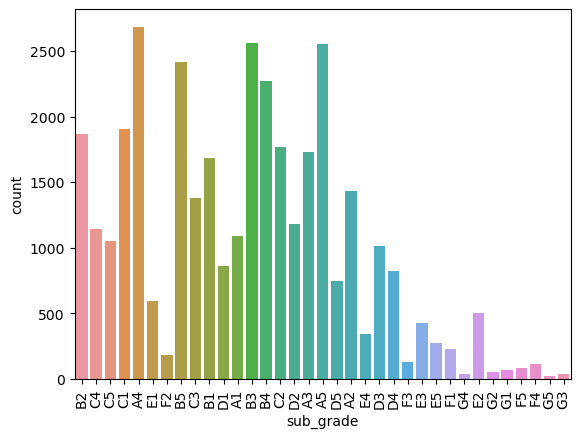

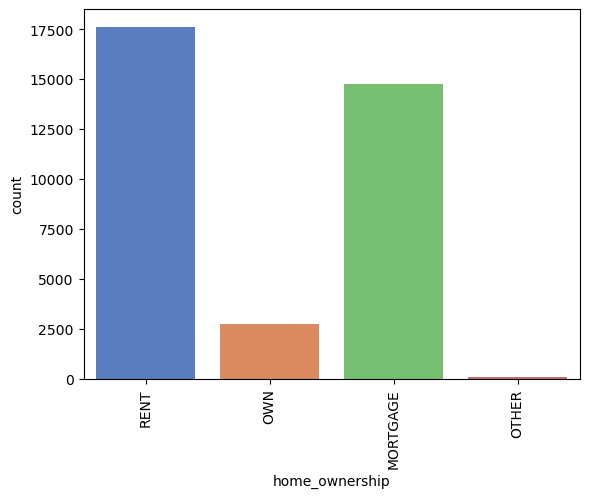

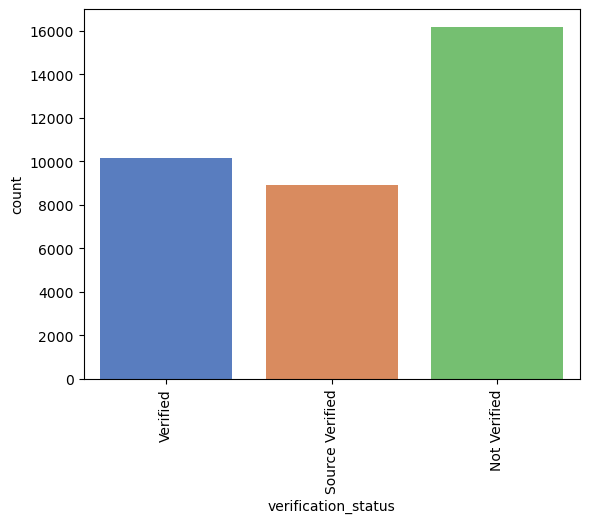

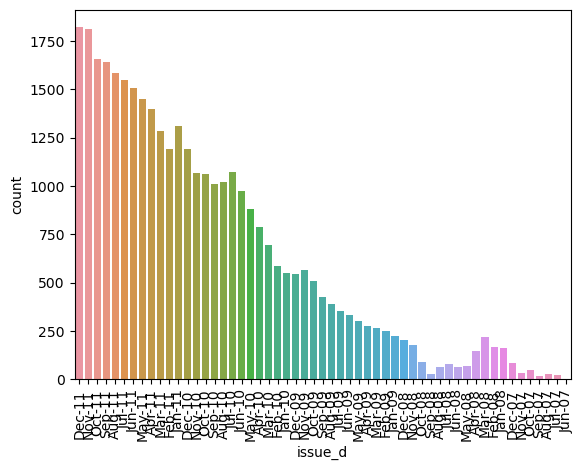

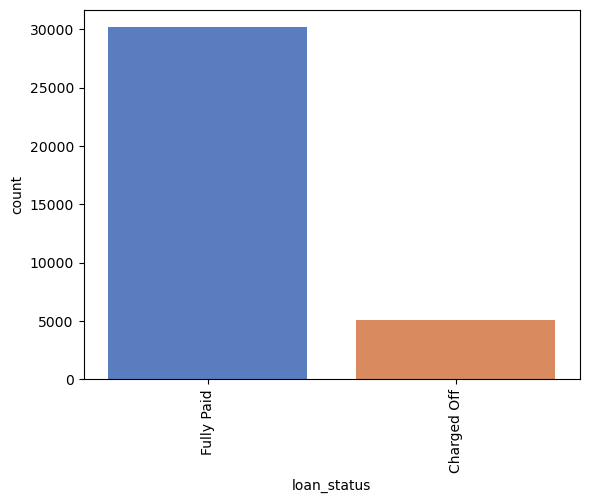

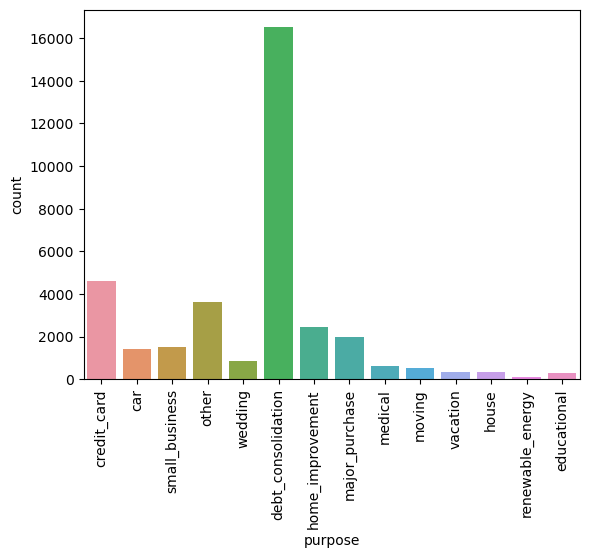

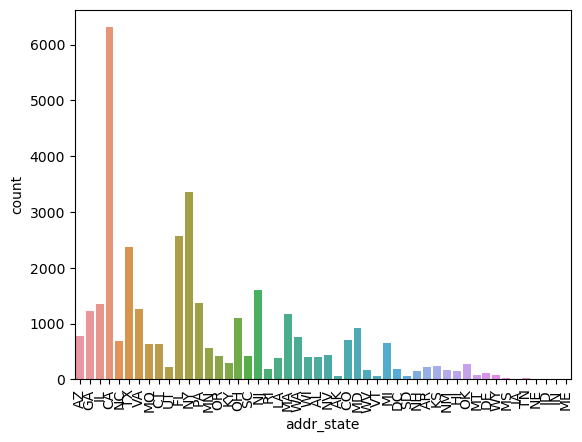

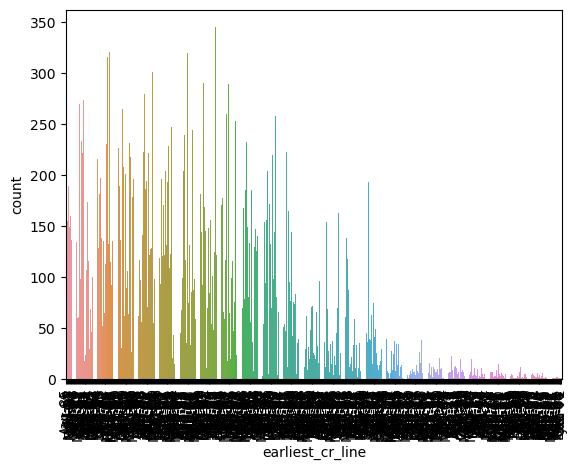

In [110]:
# Creating UniVariate graphs for Categorical/Discrete Columns :- 
for col in cat_cols:
    sns.countplot(x = loan_data_tobe_considered[col])
    plt.xticks(rotation='vertical')
    plt.show()
    


## Bivariate  Analysis 

### Numerical Vs Numerical

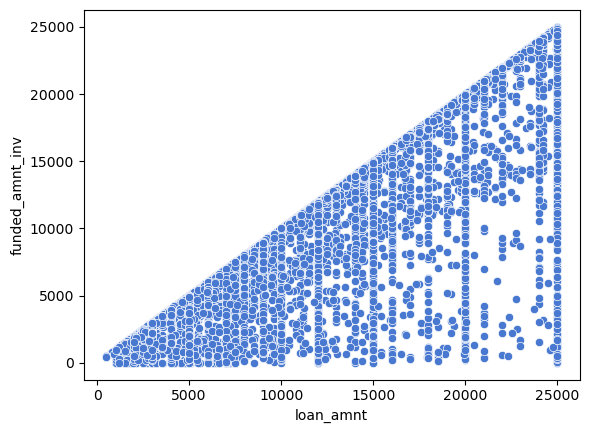

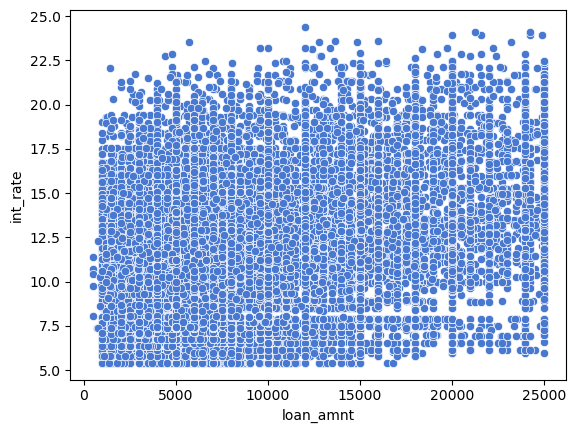

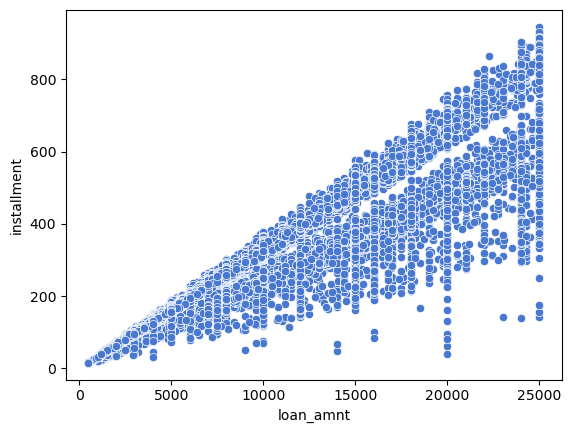

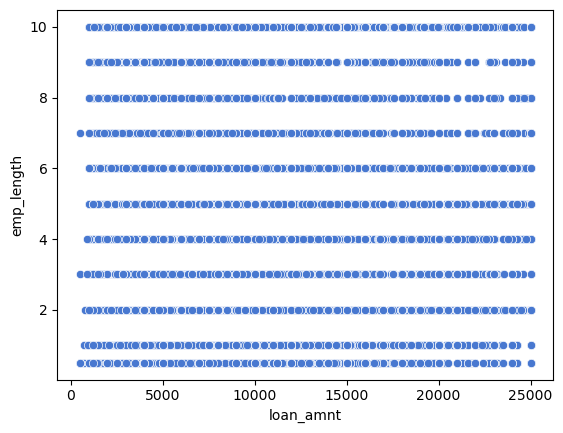

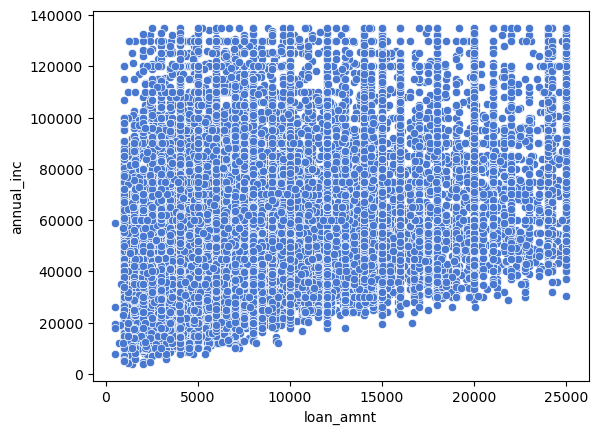

...

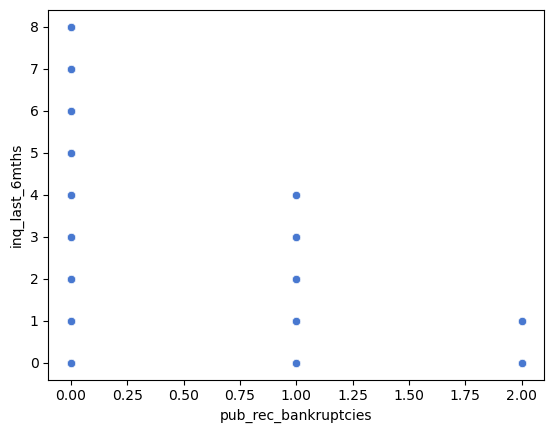

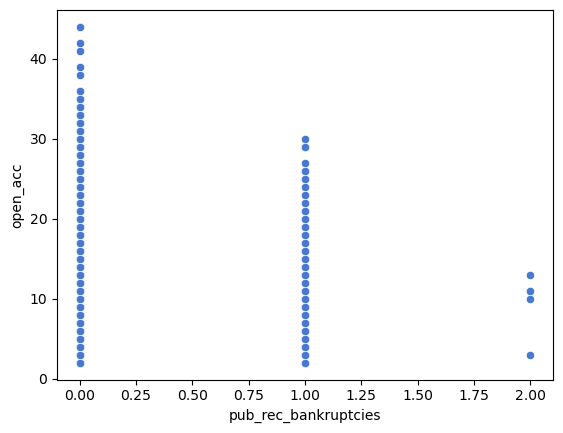

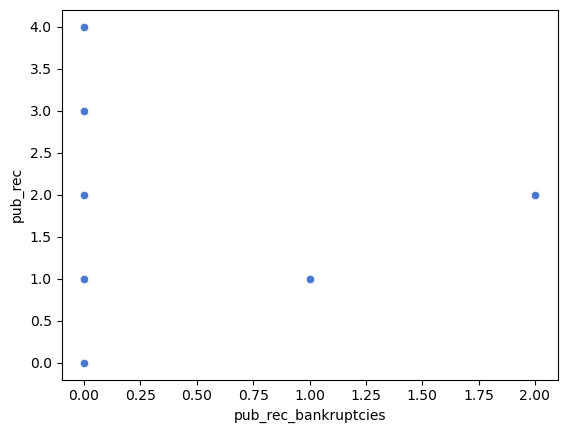

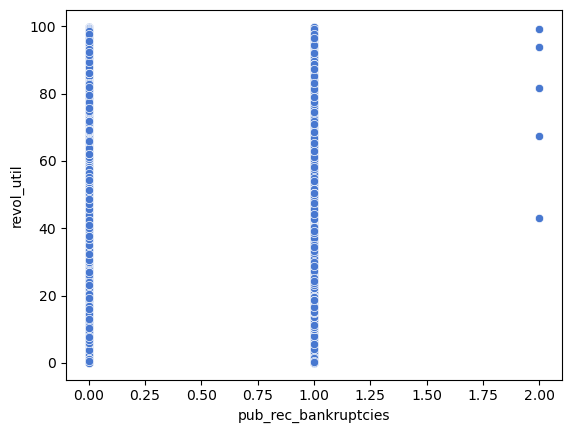

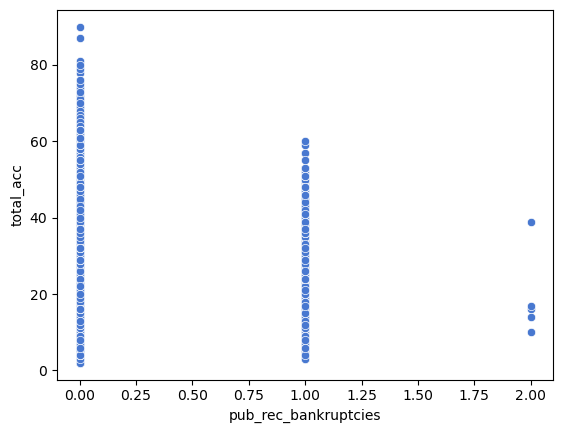

In [111]:
for col1 in cont_cols: 
    for col2 in cont_cols:
        if col1 != col2 :
            sns.scatterplot(x = loan_data_tobe_considered[col1], y = loan_data_tobe_considered[col2])
            plt.show()

### Numerical Vs Categorical 

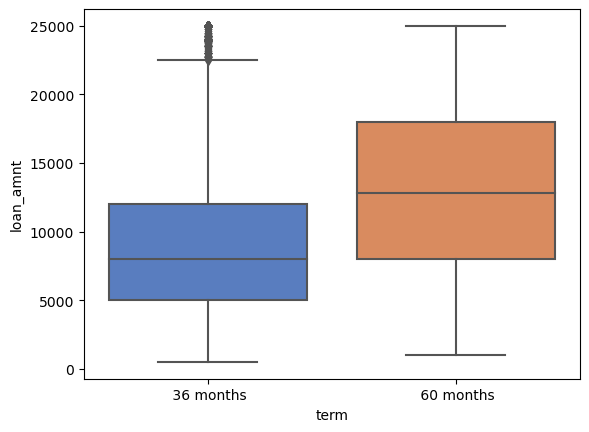

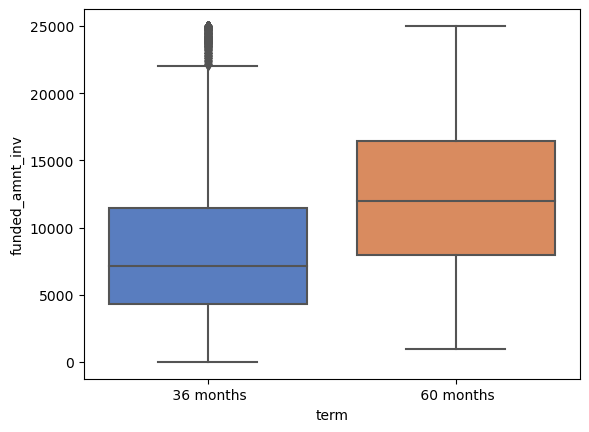

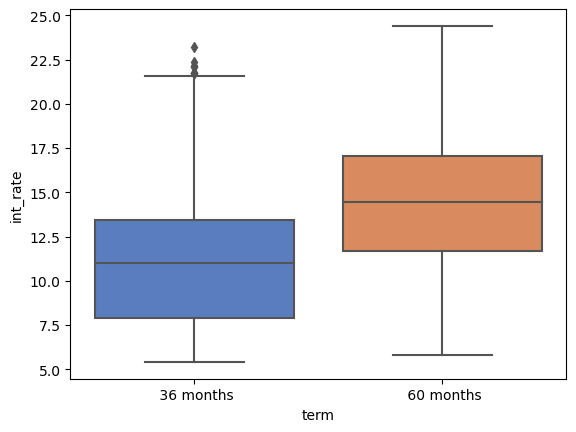

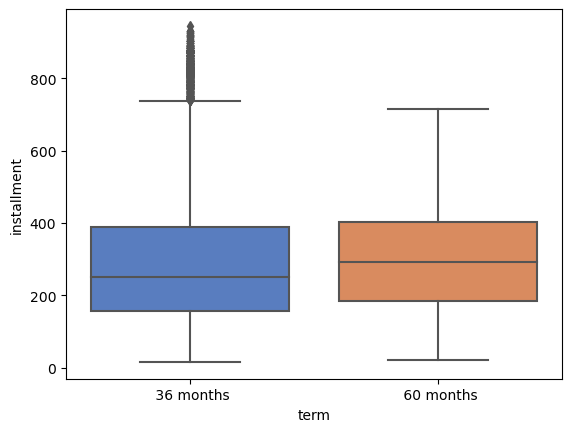

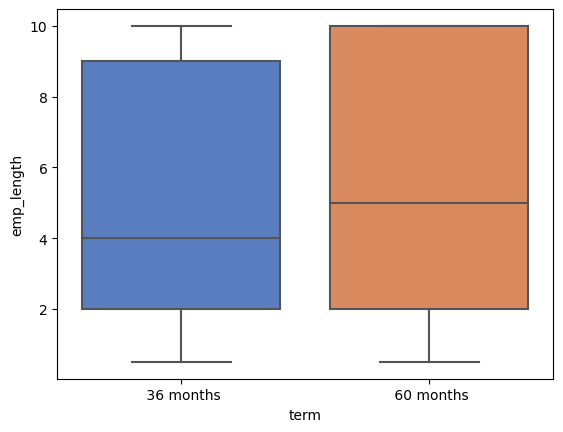

...

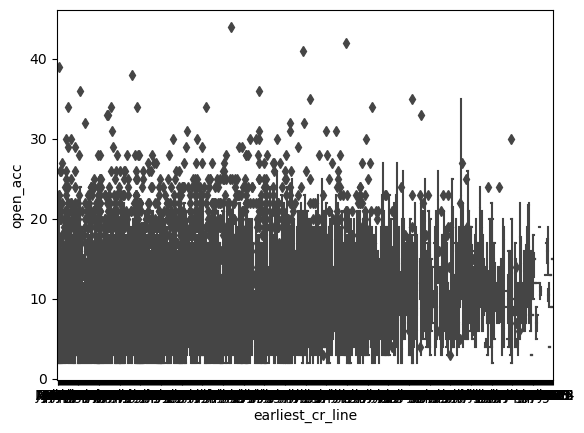

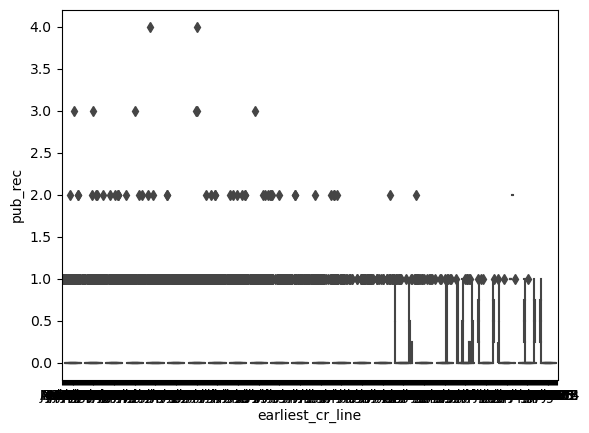

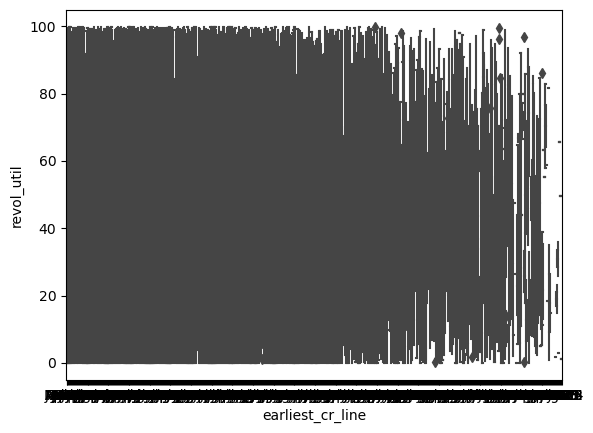

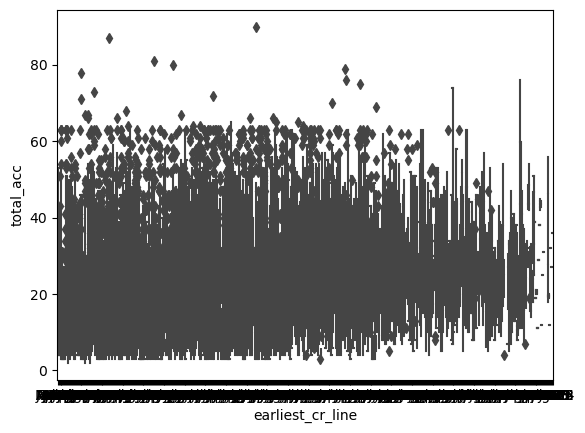

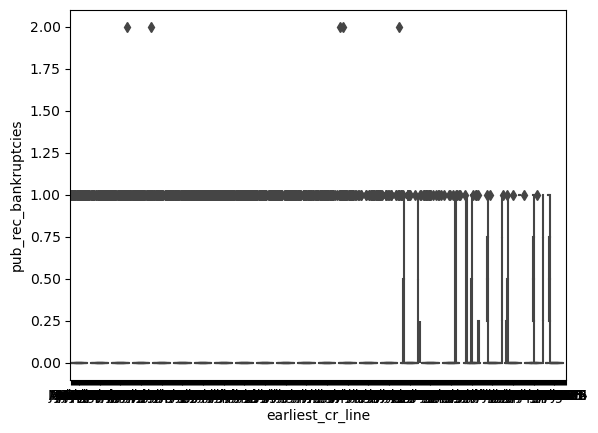

In [112]:
for col1 in cat_cols: 
    for col2 in cont_cols:
        if col1 != col2 :
            sns.boxplot(x = loan_data_tobe_considered[col1], y = loan_data_tobe_considered[col2])
            plt.show()
            

## X axis --> keep Categorical Value 
## Y axis --> keep Numerical Value 

### MultiVariate Analysis 

In [113]:
#sns.pairplot(loan_data_tobe_considered[cont_cols])
#plt.show()

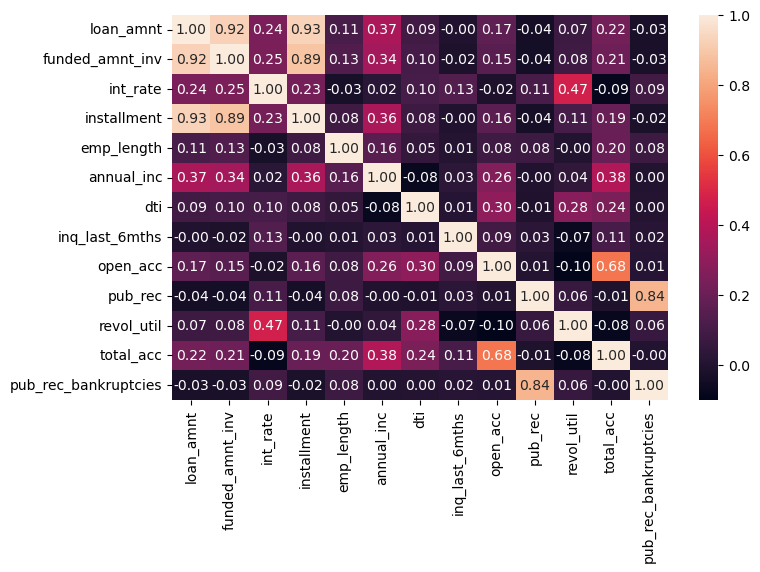

In [114]:
plt.figure(figsize = (8,5))
sns.heatmap(loan_data_tobe_considered.corr(), annot= True, fmt= '.2f')
plt.show()

In [115]:
## Correlation represents strength of relationship between variable
## Correlation lies in the range of -1 to 1
## Negative correlation  (0 to -1) shows inverse relationship --> If one is Increasing another is decresing
## Positive correlation (0 to 1) shows direct relationship --> --> If one is Increasing another is also Increasing.
## 0 correlation represents no relationship.